<div style="text-align: center;">
    <img src="dermatology_icon.png" alt=Dermatologyo" title=Dermatologyo" width="150" />
</div>


## Index

0. [Introduction](#Introduction)
1. [Data Exploration](#Data-Exploration)
2. [Data Preprocessing](#Data-Preprocessing)
    - 2.1  [Conversion of images into RGB Matrices](#RGB-Conversion)
    - 2.2  [Train, validation, test split](#Train-validation-test-split)
    - 2.3  [Normalization](#Normalization)
    - 2.4  [One-Hot Encoding](#One-Hot-Encoding)
    - 2.5  [Data Augmentation](#Data-Augmentation)
    - 2.6  [Removing hair from the images](#Removing-Hair-From-Images)
3. [Modelling](#Modelling)
    - 3.1  [Base Model](#Base-Model)
    - 3.2  [Regularized Model](#Regularized-Model)
    - 3.3  [Model With Functional API](#Model-With-Functional-API)
    - 3.4  [Model With Functional API with Data Augmentation](#Model-With-Functional-API-Augmented)
    - 3.5  [Transfer Learning Without Functional API Without Data Augmentation](#Transfer-Learnign-Without-Functional-API)
    - 3.6  [Transfer Learning With Functional API With Data Augmentation](#Transfer-Learning-With-Functional-API)
4. [Evaluation of the best Model](#Evaluation-of-the-best-Model)
5. [Gradient-weighted Class Activation Mapping](#Gradient-weighted-Class-Activation-Mapping)
6. [Future Work](#Summary-of-the-results-and-Future-Work)

<div style="background-color: yellow; color: black; padding: 10px;">
    <b>WARNING:</b> This notebook takes approximately 3 days to totally execute
</div>

<a id='Introduction'></a>
# 0. Introduction

In the realm of medical diagnostics, precision and efficiency are crucial, particularly in dermatology where visual assessment is fundamental. This project harnesses the power of Deep Learning to enhance the accuracy of skin disease classification, a critical advancement given the subtle distinctions between various skin conditions. Utilizing advanced convolutional neural networks, specifically pre-trained models like DenseNet, VGG, and ResNet, this study aims to automate the analysis of dermatological images, offering a robust tool to aid healthcare professionals. The integration of Gradient-weighted Class Activation Mapping provides further insights by highlighting key areas in images that influence the model’s predictions, thus adding a layer of interpretability to the AI’s decision-making process. Through model
training and validation, coupled with extensive hyperparameter optimization using Optuna, this project strives to bridge the gap between clinical dermatology and artificial intelligence, potentially transforming diagnostic procedures by providing swift, accurate, and interpretable results.

<a id='Data-Exploration'></a>
# 1. Data Exploration

In [109]:
# Import the necessary libraries and configurations
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import sklearn
import datetime
import os
import optuna

from tensorflow import keras
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D, Input, concatenate, GlobalAveragePooling2D, BatchNormalization
from keras.applications.densenet import DenseNet201, DenseNet121
from tensorflow.keras.models import Sequential
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, LabelEncoder, OneHotEncoder
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input, decode_predictions
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import VGG16
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import StratifiedKFold
from tensorflow.keras.models import clone_model
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard, ReduceLROnPlateau
from tensorflow.keras import backend as K
from tensorflow.keras.applications import DenseNet201
from tensorflow.keras.models import Model
from tensorflow.keras.layers import GlobalMaxPooling2D, Dense, Dropout
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam, SGD, Adagrad
from tensorflow.keras.models import load_model
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, top_k_accuracy_score

In [110]:
# Reading the dataset
dataset = pd.read_csv('fitzpatrick17k_processed.csv')

In [111]:
# Inspecting the first 3 records
dataset.head(3)

,md5hash,fitzpatrick_scale,fitzpatrick_centaur,label,nine_partition_label,three_partition_label,qc,url,url_alphanum,image_path
0,5e82a45bc5d78bd24ae9202d194423f8,3,3,drug induced pigmentary changes,inflammatory,non-neoplastic,NaN,https://www.dermaamin.com/site/images/clinical...,httpwwwdermaamincomsiteimagesclinicalpicmminoc...,images/httpwwwdermaamincomsiteimagesclinicalpi...
1,fa2911a9b13b6f8af79cb700937cc14f,1,1,photodermatoses,inflammatory,non-neoplastic,NaN,https://www.dermaamin.com/site/images/clinical...,httpwwwdermaamincomsiteimagesclinicalpicpphoto...,images/httpwwwdermaamincomsiteimagesclinicalpi...
2,d2bac3c9e4499032ca8e9b07c7d3bc40,2,3,dermatofibroma,benign dermal,benign,NaN,https://www.dermaamin.com/site/images/clinical...,httpwwwdermaamincomsiteimagesclinicalpicdderma...,images/httpwwwdermaamincomsiteimagesclinicalpi...


In [112]:
# Check the number of records and columns of the dataset
print(f'The dataset has {dataset.shape[0]} rows, and {dataset.shape[1]} columns')

The dataset has 16577 rows, and 10 columns


In [113]:
# Checking the missing values for each column (including the target)
dataset.isna().sum()

md5hash                      0
fitzpatrick_scale            0
fitzpatrick_centaur          0
label                        0
nine_partition_label         0
three_partition_label        0
qc                       16073
url                         41
url_alphanum                 0
image_path                  52
dtype: int64

In [114]:
# Check the dataset's structure, non-null count and datatype for each column (including the target)
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16577 entries, 0 to 16576
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   md5hash                16577 non-null  object
 1   fitzpatrick_scale      16577 non-null  int64 
 2   fitzpatrick_centaur    16577 non-null  int64 
 3   label                  16577 non-null  object
 4   nine_partition_label   16577 non-null  object
 5   three_partition_label  16577 non-null  object
 6   qc                     504 non-null    object
 7   url                    16536 non-null  object
 8   url_alphanum           16577 non-null  object
 9   image_path             16525 non-null  object
dtypes: int64(2), object(8)
memory usage: 1.3+ MB


In [115]:
# Generate descriptive statistics for all columns (numerical and categorical)
dataset.describe(include='all')

,md5hash,fitzpatrick_scale,fitzpatrick_centaur,label,nine_partition_label,three_partition_label,qc,url,url_alphanum,image_path
count,16577,16577.000000,16577.000000,16577,16577,16577,504,16536,16577,16525
unique,16577,NaN,NaN,114,9,3,5,16536,16577,16525
top,5e82a45bc5d78bd24ae9202d194423f8,NaN,NaN,psoriasis,inflammatory,non-neoplastic,1 Diagnostic,https://www.dermaamin.com/site/images/clinical...,httpwwwdermaamincomsiteimagesclinicalpicmminoc...,images/httpwwwdermaamincomsiteimagesclinicalpi...
freq,1,NaN,NaN,653,10886,12080,348,1,1,1
mean,NaN,2.685709,2.255113,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,1.526522,1.658569,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,-1.000000,-1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,2.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,2.000000,2.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,4.000000,3.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [116]:
# Remove wrongly diagnosed records so that the model is not exposed on badly classified data
dataset = dataset[dataset['qc'] != '3 Wrongly labelled']

In [117]:
# Checking the distribution of the qc feature, to make sure badly classified data was correctly removed
dataset['qc'].value_counts()

qc
1 Diagnostic        348
5 Potentially        97
2 Characteristic     32
4 Other              10
Name: count, dtype: int64

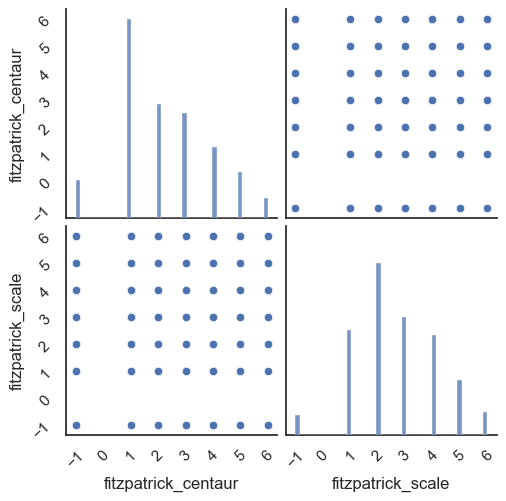

In [118]:
# Exclude 'md5hash', 'url', and 'url_alphanum'
columns_to_plot = dataset.columns.difference(['md5hash', 'url', 'url_alphanum'])

# Create pair plots for the selected columns
pairplot_fig = sns.pairplot(dataset[columns_to_plot])

# Iterate over the axes in the pairplot figure to set ticks
for ax in pairplot_fig.axes.flatten():

    ax.set_xticks(range(-1, 7))
    ax.set_yticks(range(-1, 7))
    
    for label in ax.get_xticklabels():
        label.set_rotation(45)
    for label in ax.get_yticklabels():
        label.set_rotation(45)

plt.show()

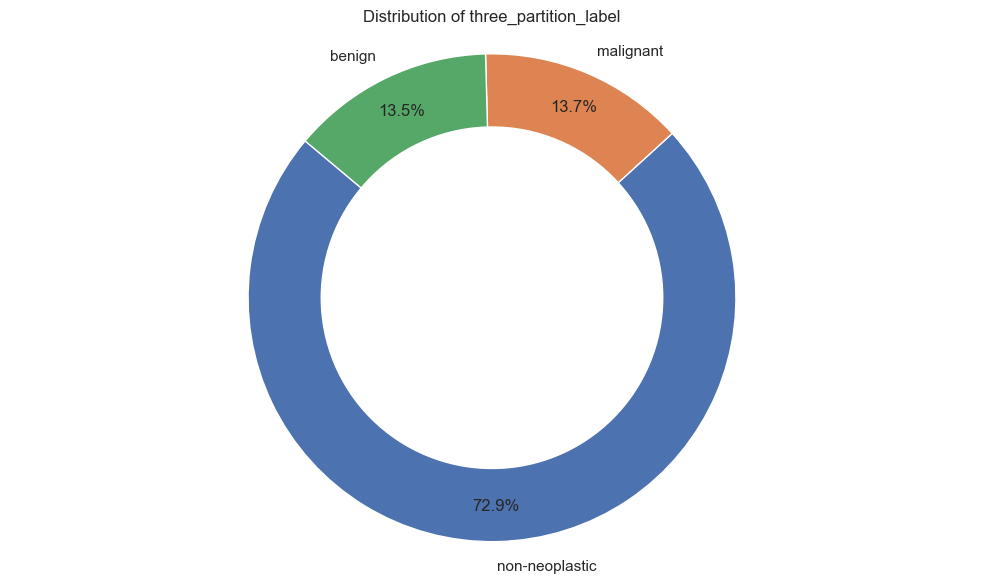

In [119]:
# Calculate value counts for the 'three_partition_label'
partition_counts = dataset['three_partition_label'].value_counts()
labels = partition_counts.index
sizes = partition_counts.values

# Calculate percentages for each slice
total = sum(sizes)
sizes_percentage = [s/total*100 for s in sizes]

# Plot the pie chart
plt.figure(figsize=(10, 6))
wedges, texts, autotexts = plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140, pctdistance=0.85)

# Draw a circle at the center to make it a donut chart
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.axis('equal')  

plt.title("Distribution of three_partition_label")
plt.tight_layout()
plt.show()

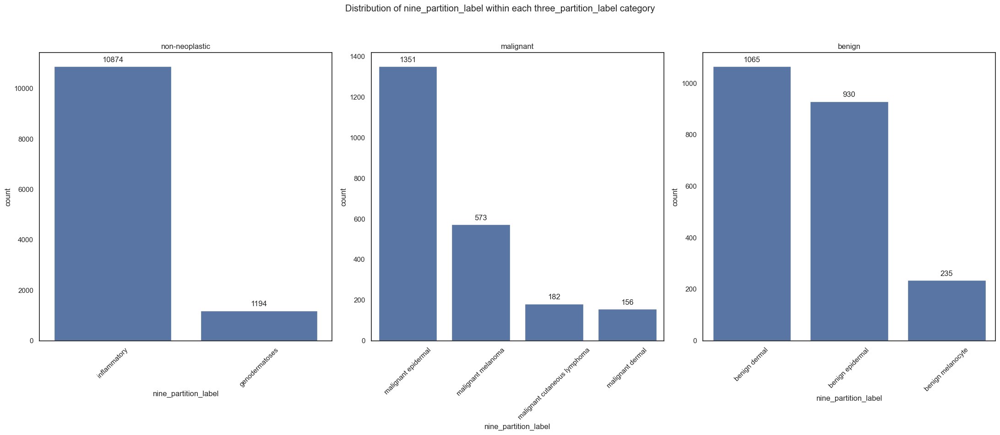

In [120]:
# Plot the distribution of the feature: nine_partition_label' through a countplot
categories = ['non-neoplastic', 'malignant', 'benign']

# Set up the matplotlib figure
fig, axes = plt.subplots(1, 3, figsize=(22, 10))
fig.suptitle("Distribution of nine_partition_label within each three_partition_label category")

for i, category in enumerate(categories):
    # Filter the dataset for the current category of 'three_partition_label'
    filtered_dataset = dataset[dataset['three_partition_label'] == category]
    
    # Plot the distribution of 'nine_partition_label' for this category
    sns.countplot(data=filtered_dataset, x='nine_partition_label', 
                  order=filtered_dataset['nine_partition_label'].value_counts().index, 
                  ax=axes[i])
    axes[i].set_title(category)
    axes[i].tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability
    
    # Add annotations (counts) above each bar
    for p in axes[i].patches:
        height = p.get_height()  
        axes[i].annotate(f'{int(height)}', 
                         (p.get_x() + p.get_width() / 2., height), 
                         ha='center', va='center', 
                         xytext=(0, 10), 
                         textcoords='offset points')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  
plt.show()

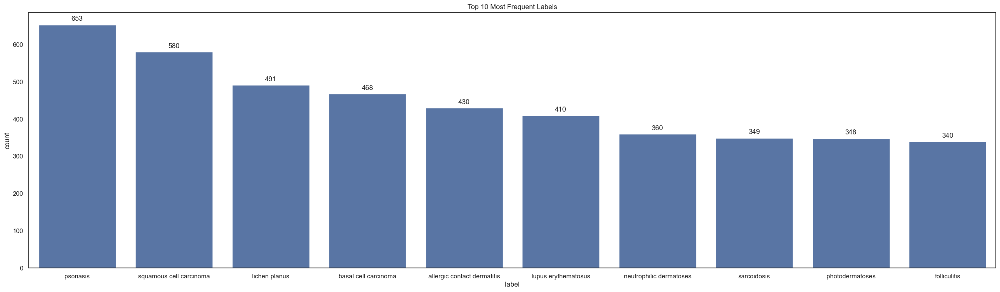

In [121]:
# Plot the distribution of the target through a countplot (limiting to the most 10 common categories)
plt.figure(figsize=(30, 8))
ax = sns.countplot(data=dataset, x='label', order=dataset['label'].value_counts().iloc[:10].index)
ax.set_title("Top 10 Most Frequent Labels")

# Annotate the count on top of each bar
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}',  
                (p.get_x() + p.get_width() / 2., p.get_height()),  
                ha='center',  
                va='center',  
                xytext=(0, 10),  
                textcoords='offset points')  

plt.show()

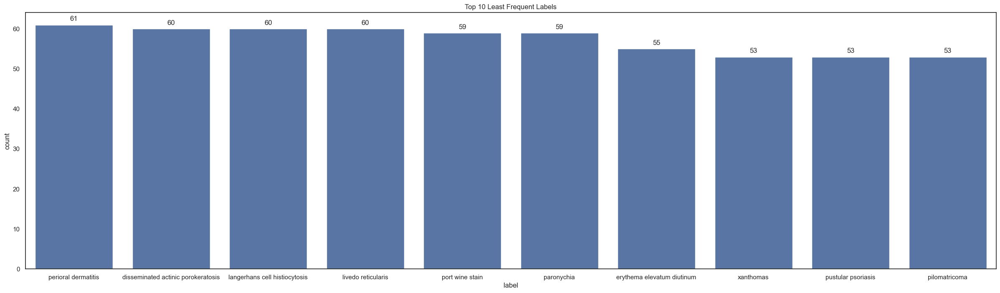

In [122]:
# Plot the distribution of the target through a countplot (limiting to the least 10 common categories)
plt.figure(figsize=(30, 8))
ax = sns.countplot(data=dataset, x='label', order=dataset['label'].value_counts().iloc[-10:].index)
ax.set_title("Top 10 Least Frequent Labels")

# Annotate the count on top of each bar
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}',  
                (p.get_x() + p.get_width() / 2., p.get_height()),  
                ha='center',  
                va='center',  
                xytext=(0, 10),  
                textcoords='offset points')  

plt.show()

<a id='Data-Preprocessing'></a>
# 2. Data Preprocessing

In [123]:
# Creating a copy of the dataset for preprocessing purposes
df_processed = dataset.copy()

In [124]:
# Drop the records without a url, since the model won't be able to learn from records without pictures
df_processed = df_processed[dataset['image_path'].notna()]

In [125]:
# Drop the irrelevant features for the models
df_processed.drop(['md5hash', 'qc', 'url_alphanum', 'three_partition_label'], axis=1, inplace=True)

In [126]:
# Remove the records where both 'fitzpatrick_scale' and 'fitzpatrick_centaur' are -1
df_processed = df_processed[~((df_processed['fitzpatrick_scale'] == -1) & (df_processed['fitzpatrick_centaur'] == -1))]

In [127]:
# Calculate an average based on both fitzpatrick columns
def calculate_fitzpatrick_average(row):
    if row['fitzpatrick_scale'] == -1 and row['fitzpatrick_centaur'] != -1:
        return row['fitzpatrick_centaur']
    elif row['fitzpatrick_centaur'] == -1 and row['fitzpatrick_scale'] != -1:
        return row['fitzpatrick_scale']
    else:
        return (row['fitzpatrick_scale'] + row['fitzpatrick_centaur']) / 2

# Apply the function to each row
df_processed['fitzpatrick_average'] = df_processed.apply(calculate_fitzpatrick_average, axis=1)

In [128]:
print(f'The dataset is now composed of {df_processed.shape[0]} rows and {df_processed.shape[1]} columns')

The dataset is now composed of 16219 rows and 7 columns


In [129]:
# Inspecting the first 3 records of the dataset
df_processed.head(3)

,fitzpatrick_scale,fitzpatrick_centaur,label,nine_partition_label,url,image_path,fitzpatrick_average
0,3,3,drug induced pigmentary changes,inflammatory,https://www.dermaamin.com/site/images/clinical...,images/httpwwwdermaamincomsiteimagesclinicalpi...,3.0
1,1,1,photodermatoses,inflammatory,https://www.dermaamin.com/site/images/clinical...,images/httpwwwdermaamincomsiteimagesclinicalpi...,1.0
2,2,3,dermatofibroma,benign dermal,https://www.dermaamin.com/site/images/clinical...,images/httpwwwdermaamincomsiteimagesclinicalpi...,2.5


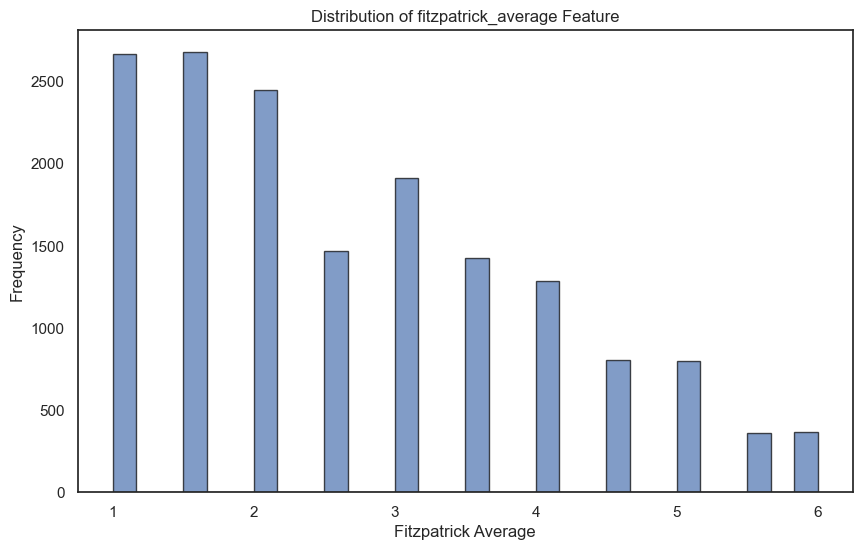

Mean: 2.646618163881867, Std: 1.3530233613814604, Min: 1.0, Max: 6.0


In [130]:
# Plotting the distribution of 'fitzpatrick_average' to decide between MinMaxScaler and Standard Scaler 
sns.set(style='white')

plt.figure(figsize=(10, 6))

plt.hist(df_processed['fitzpatrick_average'], bins=30, edgecolor='black', alpha=0.7)

plt.title('Distribution of fitzpatrick_average Feature')
plt.xlabel('Fitzpatrick Average')
plt.ylabel('Frequency')

plt.show()

# Calculate and print the mean, standard deviation, minimum and maximum values
mean_val = df_processed['fitzpatrick_average'].mean()
std_dev = df_processed['fitzpatrick_average'].std()
min_val = df_processed['fitzpatrick_average'].min()
max_val = df_processed['fitzpatrick_average'].max()

print(f"Mean: {mean_val}, Std: {std_dev}, Min: {min_val}, Max: {max_val}")

**Since the newly created feature 'fitzpatrick_average' clearly exhibits a non-normal distribution, it was decided to Normalize this feature (minimum=0, maximum=1)**

<a id='RGB-Conversion'></a>
### 2.1 Convert Images to an RGB array

In [131]:
def load_and_preprocess_image(path, target_size=(128, 128)):
    try:
        image = Image.open(path)                                # Open the image from the local path
        image = image.convert('RGB')                            # Convert to RGB
        image = np.array(image)                                 # Convert the image to a numpy array
        image = tf.convert_to_tensor(image, dtype=tf.float16)   # Convert to TensorFlow tensor
        image = tf.image.resize(image, target_size)             # Resize the image to 128x128
        image /= 255.0                                          # Normalize the image values to be between 0 and 1
        image = np.expand_dims(image, axis=0)                   # Add a batch dimension
        return image
    
    except Exception as e:
        print(f"An error occurred: {e}")
        print(f"Path: {path}")
        return None

In [132]:
# Create a new column containing the RGB matrix of the pictures
df_processed['rgb'] = df_processed['image_path'].apply(lambda x: load_and_preprocess_image(x))

In [133]:
# Initialize an empty list to store the image data
images = list()

# Iterate over each row in the dataframe
for i in range(df_processed.shape[0]):
    
    # Append the image data (from 'rgb' column) of each row to the images list
    images.append(df_processed['rgb'].iloc[i])

# Convert the list of images into a NumPy array
images = np.array(images)

In [134]:
# Reshape the array to fit the model input
reshaped_image = [np.squeeze(subarr) for subarr in images]

# Convert the list of reshaped arrays back into a single NumPy array because the model expects the input to be a NumPy array rather than a list of arrays
images = np.array(reshaped_image)

In [135]:
# Confirming the shape of the images array
images.shape

(16219, 128, 128, 3)

In [136]:
# Initialize a LabelEncoder instance that will be used to convert categorical text labels into a numeric format, making them readable for the models
label_encoder = LabelEncoder()

# Transform the labels into a numeric format
labels = label_encoder.fit_transform(np.array(df_processed['label']))

In [137]:
# Check the mapping between the diseases' names and their corresponding Label Encoder numbers
label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
label_mapping

{'acanthosis nigricans': 0,
 'acne': 1,
 'acne vulgaris': 2,
 'acquired autoimmune bullous diseaseherpes gestationis': 3,
 'acrodermatitis enteropathica': 4,
 'actinic keratosis': 5,
 'allergic contact dermatitis': 6,
 'aplasia cutis': 7,
 'basal cell carcinoma': 8,
 'basal cell carcinoma morpheiform': 9,
 'becker nevus': 10,
 'behcets disease': 11,
 'calcinosis cutis': 12,
 'cheilitis': 13,
 'congenital nevus': 14,
 'dariers disease': 15,
 'dermatofibroma': 16,
 'dermatomyositis': 17,
 'disseminated actinic porokeratosis': 18,
 'drug eruption': 19,
 'drug induced pigmentary changes': 20,
 'dyshidrotic eczema': 21,
 'eczema': 22,
 'ehlers danlos syndrome': 23,
 'epidermal nevus': 24,
 'epidermolysis bullosa': 25,
 'erythema annulare centrifigum': 26,
 'erythema elevatum diutinum': 27,
 'erythema multiforme': 28,
 'erythema nodosum': 29,
 'factitial dermatitis': 30,
 'fixed eruptions': 31,
 'folliculitis': 32,
 'fordyce spots': 33,
 'granuloma annulare': 34,
 'granuloma pyogenic': 35,
 

<a id='Train-validation-test-split'></a>
### 2.2 Split the data into train, validation, test

In [138]:
# Check the current dataframe's columns
df_processed.columns

Index(['fitzpatrick_scale', 'fitzpatrick_centaur', 'label',
       'nine_partition_label', 'url', 'image_path', 'fitzpatrick_average',
       'rgb'],
      dtype='object')

In [139]:
# Separate the dataset into numerical, categorical and images
df_numerical = df_processed[['fitzpatrick_average']]
df_categorical = df_processed[['nine_partition_label']]

# First split: separate out the training data (60%), while preserving the distribution of label classes in the original dataset, ensuring representativity
X_train_image, X_temp_image, X_train_numerical, X_temp_numerical, X_train_categorical, X_temp_categorical, y_train, y_temp = train_test_split(images, df_numerical, df_categorical, labels, test_size=0.4, stratify=labels, random_state=42)

# Second split: divide the remaining 40% into validation and test sets (50% each of the remaining data), 
# while preserving the distribution of label classes in the original dataset, ensuring representativity
X_val_image, X_test_image, X_val_numerical, X_test_numerical, X_val_categorical, X_test_categorical, y_val, y_test = train_test_split(X_temp_image, X_temp_numerical, X_temp_categorical, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

# This results in 60% training, 20% validation, and 20% test
print("Training set:", X_train_numerical.shape, y_train.shape)
print("Validation set:", X_val_numerical.shape, y_val.shape)
print("Test set:", X_test_numerical.shape, y_test.shape)

Training set: (9731, 1) (9731,)
Validation set: (3244, 1) (3244,)
Test set: (3244, 1) (3244,)


<a id='Normalization'></a>
### 2.3 Normalization

In [140]:
# Initialize the MinMaxScaler object
scaler = MinMaxScaler()

# Fit the scaler exclusively on the training data, to avoid Data Leakage
scaler.fit(X_train_numerical)

# Apply the transformation to the training, validation, and test data
X_train_numerical = scaler.transform(X_train_numerical)
X_val_numerical = scaler.transform(X_val_numerical)
X_test_numerical = scaler.transform(X_test_numerical)

# Now the 'fitzpatrick_average' column is scaled from 0 to 1 in all datasets

In [141]:
# Confirm the success of the normalization in the training dataset
print(f'Minimum fitzpatrick_average in train {X_train_numerical.min()}')
print(f'Maximum fitzpatrick_average in train {X_train_numerical.max()}')

Minimum fitzpatrick_average in train 0.0
Maximum fitzpatrick_average in train 1.0000000000000002


In [142]:
# Confirm the success of the normalization in the validation dataset
print(f'Minimum fitzpatrick_average in validation {X_val_numerical.min()}')
print(f'Maximum fitzpatrick_average in validation {X_val_numerical.max()}')

Minimum fitzpatrick_average in validation 0.0
Maximum fitzpatrick_average in validation 1.0000000000000002


In [143]:
# Confirm the success of the normalization in the testing dataset
print(f'Minimum fitzpatrick_average in test {X_test_numerical.min()}')
print(f'Maximum fitzpatrick_average in test {X_test_numerical.max()}')

Minimum fitzpatrick_average in test 0.0
Maximum fitzpatrick_average in test 1.0000000000000002


<a id='One-Hot-Encoding'></a>
### 2.4 One-hot encoding

In [144]:
# Initialize the OneHotEncoder
# Set handle_unknown='ignore' to ignore categories that weren't seen during fit
encoder = OneHotEncoder(handle_unknown='ignore')

# Fit the encoder exclusively on the training data, to avoid Data Leakage
encoder.fit(X_train_categorical)

# Transform the training data
train_encoded = encoder.transform(X_train_categorical)

# Transform the validation and test data
val_encoded = encoder.transform(X_val_categorical)
test_encoded = encoder.transform(X_test_categorical)

X_train_one_hot = pd.DataFrame(train_encoded.toarray(), columns=encoder.get_feature_names_out())
X_val_one_hot = pd.DataFrame(val_encoded.toarray(), columns=encoder.get_feature_names_out())
X_test_one_hot = pd.DataFrame(test_encoded.toarray(), columns=encoder.get_feature_names_out())

In [145]:
# Confirm the success of the one-hot encoding procedure on the training dataset
X_train_one_hot.head(3)

,nine_partition_label_benign dermal,nine_partition_label_benign epidermal,nine_partition_label_benign melanocyte,nine_partition_label_genodermatoses,nine_partition_label_inflammatory,nine_partition_label_malignant cutaneous lymphoma,nine_partition_label_malignant dermal,nine_partition_label_malignant epidermal,nine_partition_label_malignant melanoma
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [146]:
# Confirm the success of the one-hot encoding procedure on the validation dataset
X_val_one_hot.head(3)

,nine_partition_label_benign dermal,nine_partition_label_benign epidermal,nine_partition_label_benign melanocyte,nine_partition_label_genodermatoses,nine_partition_label_inflammatory,nine_partition_label_malignant cutaneous lymphoma,nine_partition_label_malignant dermal,nine_partition_label_malignant epidermal,nine_partition_label_malignant melanoma
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [147]:
# Confirm the success of the one-hot encoding procedure on the test dataset
X_test_one_hot.head(3)

,nine_partition_label_benign dermal,nine_partition_label_benign epidermal,nine_partition_label_benign melanocyte,nine_partition_label_genodermatoses,nine_partition_label_inflammatory,nine_partition_label_malignant cutaneous lymphoma,nine_partition_label_malignant dermal,nine_partition_label_malignant epidermal,nine_partition_label_malignant melanoma
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


#### Check that every target class is present in all train, validation, and test datasets

In [148]:
def check_label_representativity(train, val, test):

    # Define unique labels in train, val and test
    unique_train = np.unique(train)
    unique_val = np.unique(val)
    unique_test = np.unique(test)
    
    # Iterate through each unique label in the validation set
    for label in unique_val:
        # Check if the current label from the validation set is not in the training set
        if label not in unique_train:
            # If a label in the validation set is not found in the training set, raise an exception
            raise Exception(f'Label {label} present in validation, but not in train')
            
    # Repeat the process for the test set
    for label in unique_test:
        # Check if the current label from the test set is not in the training set
        if label not in unique_train:
            # If a label in the test set is not found in the training set, raise an exception
            raise Exception(f'Label {label} present in test, but not in train') 
            
    # If no exceptions are raised, print a message indicating label representativity is ensured
    print('Label representativity is ensured across all datasets')

check_label_representativity(y_train, y_val, y_test)

Label representativity is ensured across all datasets


<a id='Data-Augmentation'></a>
### 2.5 Data Augmentation

In [149]:
# Data Augmentation setup
data_augmentation = ImageDataGenerator(
    horizontal_flip=True,
    vertical_flip=True,
    zoom_range=0.2 # Zoom in by 20% maximum (randomly zoom images up to 20%)
)

# Initialize empty lists to store augmented data
augmented_images = []
augmented_numerical = [] 
augmented_one_hot = []  
augmented_labels = []

# It was determined that the number of samples to aim for each class after augmentation, to achieve class balance, was so that each class would represent 3% of the original
# training dataset's total length. Naturally, since the dataset's length will get much bigger, each class will end up composing approximately 0.9% of the augmented
# training dataset
target_samples_per_class = int(len(y_train) * 0.03)

# Calculate how many samples each class needs based on the target
unique, counts = np.unique(y_train, return_counts=True)
class_needs = {class_label: max(0, target_samples_per_class - count) for class_label, count in zip(unique, counts)}

# Perform augmentation
for class_label, needed_samples in class_needs.items():
    if needed_samples <= 0:
        continue  # Skip classes that don't need augmentation

    # Indices of the current class in the dataset
    class_indices = np.where(y_train == class_label)[0]
    
    print(f'Augmenting class: {class_label}')

    # Augment data for this class
    for _ in range(needed_samples):
        idx = np.random.choice(class_indices)
        image_to_augment = X_train_image[idx].reshape((1,) + X_train_image[idx].shape)
        one_hot = X_train_one_hot.iloc[idx].values  # Corresponding one-hot features
        numerical = X_train_numerical[idx]          # Corresponding numerical feature
        
        it = data_augmentation.flow(image_to_augment, batch_size=1)
        augmented_image = next(it)[0]

        # Append the augmented data
        augmented_images.append(augmented_image)
        augmented_numerical.append(numerical)
        augmented_one_hot.append(one_hot)
        augmented_labels.append(class_label)

# Convert lists to numpy arrays
augmented_images = np.array(augmented_images)
augmented_one_hot = np.array(augmented_one_hot)
augmented_numerical = np.array(augmented_numerical)
augmented_labels = np.array(augmented_labels)

# Concatenate the original and augmented data
X_train_image_augmented = np.concatenate((X_train_image, augmented_images))
X_train_one_hot_augmented = np.concatenate((X_train_one_hot, augmented_one_hot), axis=0)
X_train_numerical_augmented = np.concatenate((X_train_numerical, augmented_numerical), axis=0)
y_train_augmented = np.concatenate((y_train, augmented_labels))

# Shuffle the augmented dataset
shuffle_indices = np.random.permutation(len(X_train_image_augmented))
X_train_image_augmented = X_train_image_augmented[shuffle_indices]
X_train_numerical_augmented = X_train_numerical_augmented[shuffle_indices]
X_train_one_hot_augmented = X_train_one_hot_augmented[shuffle_indices]
y_train_augmented = y_train_augmented[shuffle_indices]

Augmenting class: 0
Augmenting class: 1
Augmenting class: 2
Augmenting class: 3
Augmenting class: 4
Augmenting class: 5
Augmenting class: 6
Augmenting class: 7
Augmenting class: 8
Augmenting class: 9
Augmenting class: 10
Augmenting class: 11
Augmenting class: 12
Augmenting class: 13
Augmenting class: 14
Augmenting class: 15
Augmenting class: 16
Augmenting class: 17
Augmenting class: 18
Augmenting class: 19
Augmenting class: 20
Augmenting class: 21
Augmenting class: 22
Augmenting class: 23
Augmenting class: 24
Augmenting class: 25
Augmenting class: 26
Augmenting class: 27
Augmenting class: 28
Augmenting class: 29
Augmenting class: 30
Augmenting class: 31
Augmenting class: 32
Augmenting class: 33
Augmenting class: 34
Augmenting class: 35
Augmenting class: 36
Augmenting class: 37
Augmenting class: 38
Augmenting class: 39
Augmenting class: 40
Augmenting class: 41
Augmenting class: 42
Augmenting class: 43
Augmenting class: 44
Augmenting class: 45
Augmenting class: 46
Augmenting class: 47
Au

In [150]:
# Confirming the shape of the augmented training dataset
X_train_image_augmented.shape

(33308, 128, 128, 3)

In [151]:
label_series = pd.Series(y_train_augmented)

pd.set_option('display.max_rows', None)

# Get the distribution of labels, sort by values in descending order to see the proportions
label_distribution = label_series.value_counts(normalize=True).sort_values(ascending=False)

print("Label Distribution After Data Augmentation:\n", label_distribution)

Label Distribution After Data Augmentation:
 86     0.011589
98     0.009908
40     0.008737
69     0.008737
20     0.008737
34     0.008737
19     0.008737
1      0.008737
107    0.008737
88     0.008737
42     0.008737
109    0.008737
21     0.008737
106    0.008737
89     0.008737
18     0.008737
6      0.008737
103    0.008737
31     0.008737
99     0.008737
14     0.008737
66     0.008737
79     0.008737
67     0.008737
92     0.008737
2      0.008737
45     0.008737
27     0.008737
48     0.008737
96     0.008737
63     0.008737
76     0.008737
105    0.008737
32     0.008737
3      0.008737
80     0.008737
100    0.008737
101    0.008737
94     0.008737
4      0.008737
97     0.008737
65     0.008737
50     0.008737
44     0.008737
77     0.008737
46     0.008737
49     0.008737
73     0.008737
23     0.008737
84     0.008737
29     0.008737
8      0.008737
11     0.008737
112    0.008737
102    0.008737
30     0.008737
85     0.008737
13     0.008737
82     0.008737
41     0.00

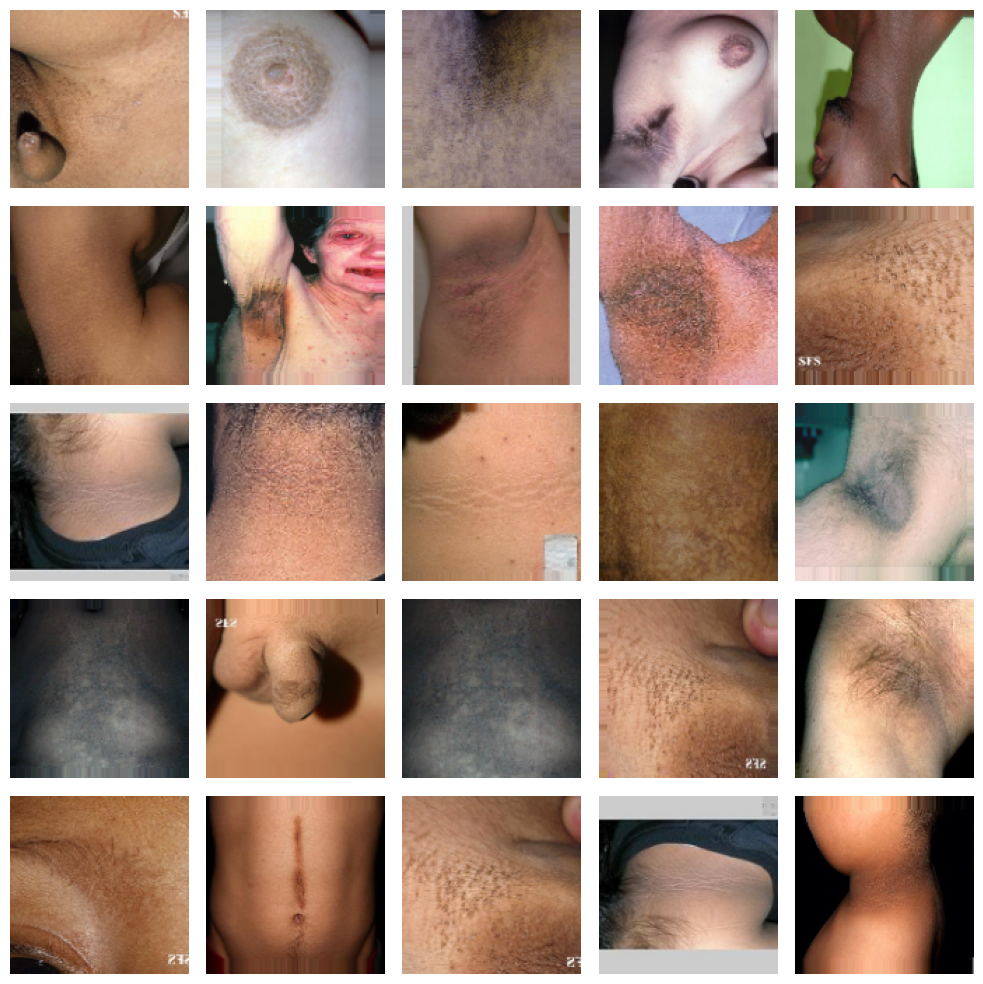

In [153]:
def plot_images(images, rows, cols):

    fig, axes = plt.subplots(rows, cols, figsize=(cols*2, rows*2))
    axes = axes.flatten()

    # Loop through the provided images and corresponding axes
    for img, ax in zip(images, axes):
        ax.imshow(img.astype("float32"), cmap='gray')
        ax.axis('off')

    plt.tight_layout()  
    plt.show()

# Select a subset of 25 augmented images to visualize
num_images_to_show = 25
subset_augmented_images = augmented_images[:num_images_to_show]

# Plot the images using the function above with a 5x5 grid
plot_images(subset_augmented_images, rows=5, cols=5)

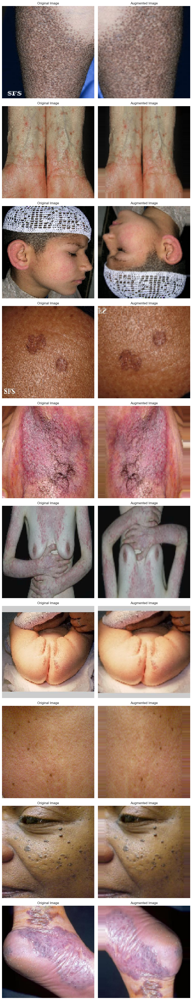

In [154]:
def show_original_and_augmented(images):

    num_images = len(images)
    fig, axes = plt.subplots(num_images, 2, figsize=(10, num_images * 5))
    
    for i, image in enumerate(images):
        
        # Generate an augmented image
        it = data_augmentation.flow(image[np.newaxis, ...], batch_size=1)
        augmented_image = next(it)[0]
        
        original_display = np.clip(image.astype('float32'), 0, 1)
        augmented_display = np.clip(augmented_image.astype('float32'), 0, 1)
        
        # Display original image
        axes[i, 0].imshow(original_display)
        axes[i, 0].set_title('Original Image')
        axes[i, 0].axis('off')
        
        # Display augmented image
        axes[i, 1].imshow(augmented_display)
        axes[i, 1].set_title('Augmented Image')
        axes[i, 1].axis('off')
    
    plt.tight_layout()
    plt.show()

# Select 10 example images from the training set
example_images = X_train_image[:10]

# Show original and augmented images
show_original_and_augmented(example_images)

<a id='Removing-Hair-From-Images'></a>
### 2.6 Removing hair from the images

**The following cell is responsible for, using the original images, transform them by removing their body hair. It is in raw format because it has already been executed and the created folder 'images_hair_removed' is present in the submitted files.**

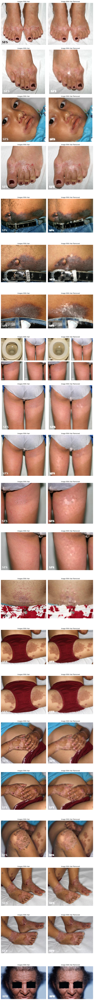

In [155]:
# Paths to the directories
dir1 = 'images'
dir2 = 'images_hair_removed'

# List and sort the files in each directory
files1 = [f for f in os.listdir(dir1) if f.endswith('.jpg')]
files2 = [f for f in os.listdir(dir2) if f.endswith('.jpg')]

# Select the subset of images from index 40th till 60th. This was done empirically to make sure we would be able to show examples of hair being correctly 
# removed and pictures with no hair being damaged in quality
files1 = files1[40:61]
files2 = files2[40:61]

def compare_images(folder1, folder2, files1, files2):
    num_images = len(files1)
    fig, axes = plt.subplots(num_images, 2, figsize=(10, num_images * 5))

    for i, (file1, file2) in enumerate(zip(files1, files2)):
        # Load the images
        img1 = Image.open(os.path.join(folder1, file1))
        img2 = Image.open(os.path.join(folder2, file2))
        
        # Convert images to RGB
        img1 = img1.convert('RGB')
        img2 = img2.convert('RGB')

        # Display original image from images
        axes[i, 0].imshow(img1)
        axes[i, 0].set_title('Images With Hair')
        axes[i, 0].axis('off')
        
        # Display corresponding image from images_hair_removed
        axes[i, 1].imshow(img2)
        axes[i, 1].set_title('Image With Hair Removed')
        axes[i, 1].axis('off')
    
    plt.tight_layout()
    plt.show()

compare_images(dir1, dir2, files1, files2)

<a id='Modelling'></a>
# 3. Modelling

In [156]:
# Delete extra datasets to save memory
del X_temp_image
del X_temp_numerical
del X_temp_categorical
del y_temp
del images

In [157]:
def get_model_metrics(model_path, y_test, X_test, k=3):  # Path to the best model saved during the trial
    
    best_model = load_model(model_path)
    
    # Print the model summary
    print(best_model.summary())
    
    # Predicting on the test set
    scores = best_model.predict(X_test)
    y_pred = np.argmax(scores, axis=1)
    
    # Evaluating the predictions
    test_accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average='weighted')
    conf_matrix = confusion_matrix(y_test, y_pred)
    top3_accuracy = top_k_accuracy_score(y_test, scores, k=k)
    
    # Print metrics
    print('\n')
    print(f"Test Accuracy: {test_accuracy}")
    print(f"F1-Score on Test Set: {f1}")
    print(f'Top 3 Accuracy: {top3_accuracy}')
    print('\n')
    print("Confusion Matrix:")

    # Temporarily adjust NumPy print options to display the entire array
    np.set_printoptions(threshold=np.inf)
    print(conf_matrix)
    np.set_printoptions(threshold=1000)

    # Visualize the confusion matrix using seaborn
    plt.figure(figsize=(25, 25))  
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()


def get_top_k_evolution_for_model(model_path, y_test, X_test, k_maximum=10):  # Path to the best model saved during the trial
    
    best_model = load_model(model_path)
    
    # Predicting on the test set
    scores = best_model.predict(X_test)

    accuracies_tops = []
    for k in range(1, k_maximum + 1):
        accuracy_for_k_top = top_k_accuracy_score(y_test, scores, k=k)
        accuracies_tops.append(accuracy_for_k_top)
    
    sns.set(style="white") 
    
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, k_maximum + 1), accuracies_tops, marker='o', markersize=8, color='blue', linewidth=2)

    # Annotate each point with its value, slightly above the point
    offset = max(accuracies_tops) * 0.1
    for i, acc in enumerate(accuracies_tops):
        plt.text(i + 1, acc + offset, f'{acc:.2f}', color='black', ha='center')

    # Adding plot title and labels
    plt.title('Top-k Accuracy Evolution', fontsize=16)
    plt.xlabel('Top k', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.xticks(range(1, k_maximum + 1))
    plt.xlim(0, k_maximum + 1)
    plt.ylim(0, 1)

    plt.show()

<a id='Base-Model'></a>
### 3.1 Base Model

In [158]:
def create_base_model(trial):
    
    # Optimizers to be tuned
    optimizer_options = ['Adam', 'SGD', 'Adagrad']
    optimizer_selected = trial.suggest_categorical('optimizer', optimizer_options)
    
    # Initialize the optimizer with a tuned learning rate
    if optimizer_selected == 'Adam':
        optimizer = Adam(learning_rate=trial.suggest_float("adam_lr", 1e-3, 1e-2, log=True))
    elif optimizer_selected == 'SGD':
        optimizer = SGD(learning_rate=trial.suggest_float("sgd_lr", 1e-3, 1e-2, log=True))
    elif optimizer_selected == 'Adagrad':
        optimizer = Adagrad(learning_rate=trial.suggest_float("adagrad_lr", 1e-3, 1e-2, log=True))

    # Base model architecture
    model = Sequential([
        Conv2D(10, kernel_size=3, activation='relu', input_shape=(128, 128, 3)), 
        Flatten(),
        Dense(114, activation='softmax')
    ])

    # Compile the model
    model.compile(optimizer=optimizer,
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    return model


def objective_for_base_model(trial):
    model = create_base_model(trial)
    model_checkpoint = ModelCheckpoint("models/3.1/3.1_trial_{}.h5".format(trial.number), monitor='val_loss', save_best_only=True, verbose=1)
    
    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.0001, verbose=1)

    # Fit the model
    history = model.fit(
        x=X_train_image, y=y_train,
        validation_data=(X_val_image, y_val),
        epochs=20, verbose=0,

        # Batch size to be tuned
        batch_size=trial.suggest_categorical('batch_size', [32, 64, 128]),
        callbacks=[early_stopping, reduce_lr, model_checkpoint]
    )
    
    # Evaluation
    loss, accuracy = model.evaluate(X_val_image, y_val, verbose=0)
    return accuracy

# Create the Optuna study
study = optuna.create_study(direction='maximize')
study.optimize(objective_for_base_model, n_trials=5)

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2024-04-27 11:53:29,882] A new study created in memory with name: no-name-a1eb2684-0727-4b70-9886-9e6c2fd4636c






Epoch 1: val_loss improved from inf to 4.82604, saving model to models/3.1\3.1_trial_0.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 4.82604 to 4.50521, saving model to models/3.1\3.1_trial_0.h5

Epoch 3: val_loss did not improve from 4.50521

Epoch 4: val_loss did not improve from 4.50521

Epoch 5: val_loss improved from 4.50521 to 4.49952, saving model to models/3.1\3.1_trial_0.h5

Epoch 6: val_loss did not improve from 4.49952

Epoch 7: val_loss did not improve from 4.49952

Epoch 8: ReduceLROnPlateau reducing learning rate to 0.0009962146170437336.

Epoch 8: val_loss did not improve from 4.49952

Epoch 9: val_loss improved from 4.49952 to 4.28296, saving model to models/3.1\3.1_trial_0.h5

Epoch 10: val_loss improved from 4.28296 to 4.27301, saving model to models/3.1\3.1_trial_0.h5

Epoch 11: val_loss did not improve from 4.27301

Epoch 12: val_loss improved from 4.27301 to 4.25859, saving model to models/3.1\3.1_trial_0.h5

Epoch 13: val_loss improved from 4.25859 to 4.25165, saving model to models/3.1\3.1_trial_0.h5

Epoch 14: val_loss did not improve from 4.25165

Epoch 15: v

[I 2024-04-27 12:00:44,838] Trial 0 finished with value: 0.0770653486251831 and parameters: {'optimizer': 'SGD', 'sgd_lr': 0.00996214608418358, 'batch_size': 64}. Best is trial 0 with value: 0.0770653486251831.



Epoch 1: val_loss improved from inf to 4.59535, saving model to models/3.1\3.1_trial_1.h5

Epoch 2: val_loss did not improve from 4.59535

Epoch 3: val_loss did not improve from 4.59535

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.00018923658644780518.

Epoch 4: val_loss did not improve from 4.59535

Epoch 5: val_loss did not improve from 4.59535

Epoch 6: val_loss did not improve from 4.59535


[I 2024-04-27 12:03:04,772] Trial 1 finished with value: 0.045314427465200424 and parameters: {'optimizer': 'Adam', 'adam_lr': 0.0018923658949041465, 'batch_size': 128}. Best is trial 0 with value: 0.0770653486251831.



Epoch 1: val_loss improved from inf to 6.18900, saving model to models/3.1\3.1_trial_2.h5

Epoch 2: val_loss improved from 6.18900 to 5.14964, saving model to models/3.1\3.1_trial_2.h5

Epoch 3: val_loss improved from 5.14964 to 4.69018, saving model to models/3.1\3.1_trial_2.h5

Epoch 4: val_loss did not improve from 4.69018

Epoch 5: val_loss did not improve from 4.69018

Epoch 6: ReduceLROnPlateau reducing learning rate to 0.00011220724554732442.

Epoch 6: val_loss did not improve from 4.69018

Epoch 7: val_loss improved from 4.69018 to 4.37735, saving model to models/3.1\3.1_trial_2.h5

Epoch 8: val_loss improved from 4.37735 to 4.37192, saving model to models/3.1\3.1_trial_2.h5

Epoch 9: val_loss improved from 4.37192 to 4.36923, saving model to models/3.1\3.1_trial_2.h5

Epoch 10: val_loss improved from 4.36923 to 4.36616, saving model to models/3.1\3.1_trial_2.h5

Epoch 11: val_loss improved from 4.36616 to 4.36475, saving model to models/3.1\3.1_trial_2.h5

Epoch 12: val_loss 

[I 2024-04-27 12:09:57,268] Trial 2 finished with value: 0.06134402006864548 and parameters: {'optimizer': 'SGD', 'sgd_lr': 0.0011220724441092396, 'batch_size': 64}. Best is trial 0 with value: 0.0770653486251831.



Epoch 1: val_loss improved from inf to 4.51355, saving model to models/3.1\3.1_trial_3.h5

Epoch 2: val_loss improved from 4.51355 to 4.49838, saving model to models/3.1\3.1_trial_3.h5

Epoch 3: val_loss did not improve from 4.49838

Epoch 4: val_loss did not improve from 4.49838

Epoch 5: ReduceLROnPlateau reducing learning rate to 0.0008976656012237073.

Epoch 5: val_loss did not improve from 4.49838

Epoch 6: val_loss did not improve from 4.49838

Epoch 7: val_loss did not improve from 4.49838


[I 2024-04-27 12:15:27,267] Trial 3 finished with value: 0.04007398337125778 and parameters: {'optimizer': 'Adam', 'adam_lr': 0.008976656256232906, 'batch_size': 32}. Best is trial 0 with value: 0.0770653486251831.



Epoch 1: val_loss improved from inf to 5.97173, saving model to models/3.1\3.1_trial_4.h5

Epoch 2: val_loss improved from 5.97173 to 5.01165, saving model to models/3.1\3.1_trial_4.h5

Epoch 3: val_loss improved from 5.01165 to 4.71862, saving model to models/3.1\3.1_trial_4.h5

Epoch 4: val_loss did not improve from 4.71862

Epoch 5: val_loss did not improve from 4.71862

Epoch 6: ReduceLROnPlateau reducing learning rate to 0.00025172142777591945.

Epoch 6: val_loss did not improve from 4.71862

Epoch 7: val_loss improved from 4.71862 to 4.36727, saving model to models/3.1\3.1_trial_4.h5

Epoch 8: val_loss improved from 4.36727 to 4.35981, saving model to models/3.1\3.1_trial_4.h5

Epoch 9: val_loss improved from 4.35981 to 4.35477, saving model to models/3.1\3.1_trial_4.h5

Epoch 10: val_loss improved from 4.35477 to 4.35417, saving model to models/3.1\3.1_trial_4.h5

Epoch 11: val_loss improved from 4.35417 to 4.35024, saving model to models/3.1\3.1_trial_4.h5

Epoch 12: val_loss 

[I 2024-04-27 12:22:11,723] Trial 4 finished with value: 0.07182490825653076 and parameters: {'optimizer': 'Adagrad', 'adagrad_lr': 0.002517214219894954, 'batch_size': 128}. Best is trial 0 with value: 0.0770653486251831.


Number of finished trials: 5
Best trial: {'optimizer': 'SGD', 'sgd_lr': 0.00996214608418358, 'batch_size': 64}


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 10)      280       
                                                                 
 flatten (Flatten)           (None, 158760)            0         
                                                                 
 dense (Dense)               (None, 114)               18098754  
                                                                 
Total params: 18099034 (69.04 MB)
Trainable params: 18099034 (69.04 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
None
102/102 [==============================] - 3s 28ms/step


Test Accuracy: 0.07614056720098644
F1-Score on Test Set: 0.05280443584833658
Top 3 Accuracy: 0.1680024660912454


Confusion Matrix:
[[ 0  0  0  0  0  0  0  0  3  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
   0  0  

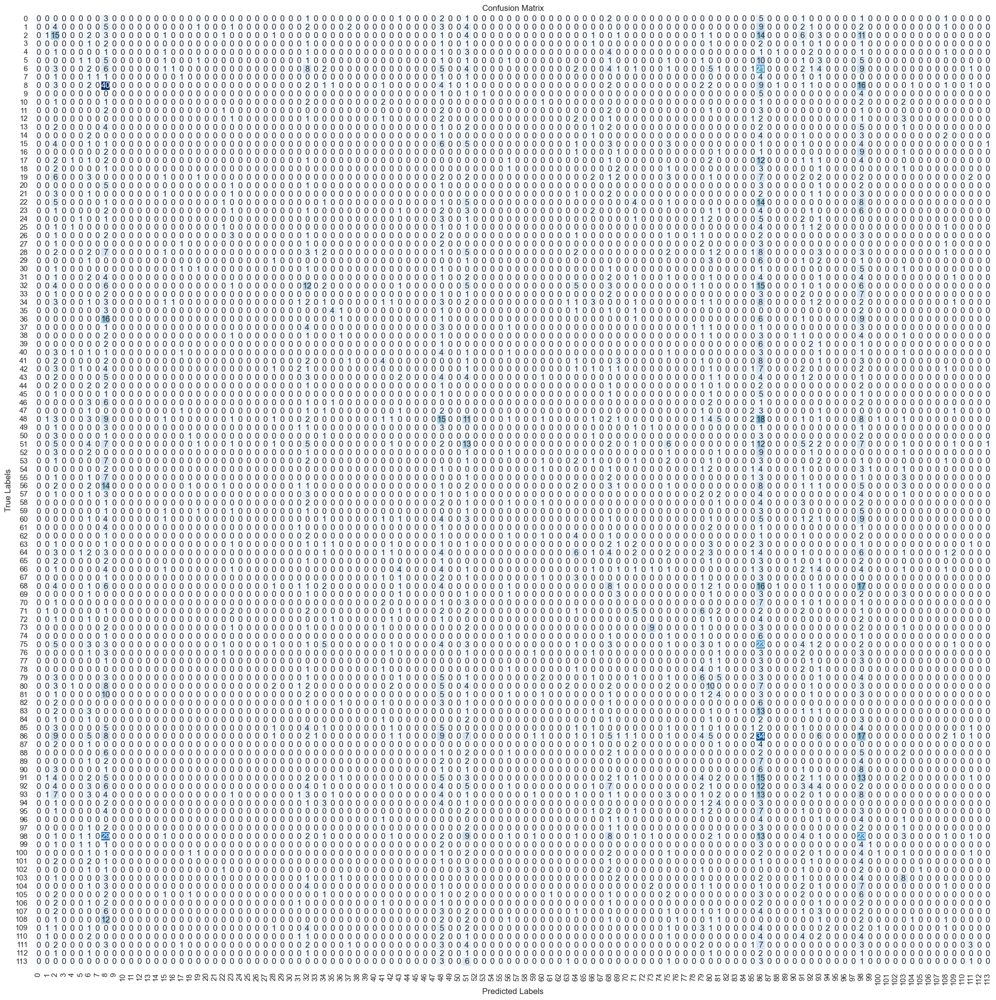

In [159]:
get_model_metrics("models/3.1/3.1_trial_{}.h5".format(study.best_trial.number), y_test, X_test_image)

102/102 [==============================] - 3s 33ms/step


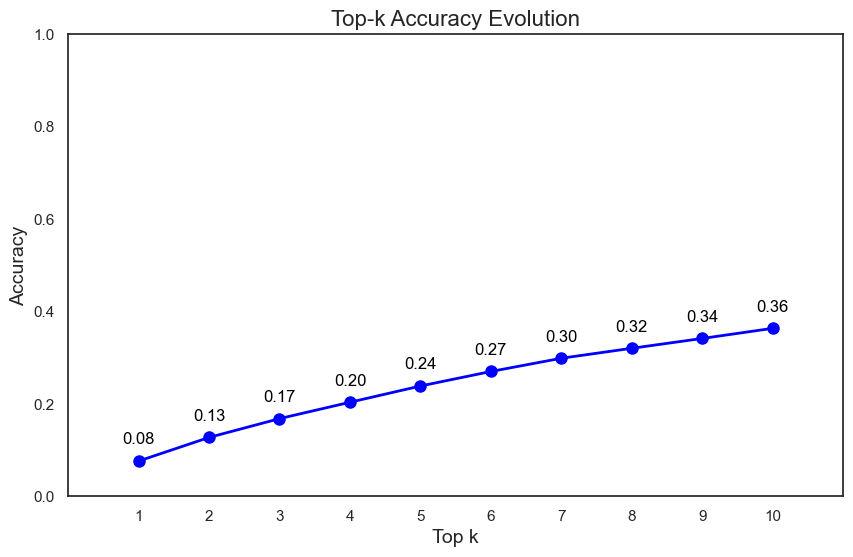

In [160]:
get_top_k_evolution_for_model("models/3.1/3.1_trial_{}.h5".format(study.best_trial.number), y_test, X_test_image, k_maximum=10)

<a id='Regularized-Model'></a>
### 3.2 Regularized Model

In [83]:
def create_model(trial):

    # Optimizers to tune
    optimizer_options = ['Adam', 'SGD', 'Adagrad']
    optimizer_selected = trial.suggest_categorical('optimizer', optimizer_options)

    # Learning rates to tune
    if optimizer_selected == 'Adam':
        optimizer = Adam(learning_rate=trial.suggest_float("adam_lr", 1e-3, 1e-2, log=True))
    elif optimizer_selected == 'SGD':
        optimizer = SGD(learning_rate=trial.suggest_float("sgd_lr", 1e-3, 1e-2, log=True))
    elif optimizer_selected == 'Adagrad':
        optimizer = Adagrad(learning_rate=trial.suggest_float("adagrad_lr", 1e-3, 1e-2, log=True))

    # Regularized model architecture
    model = Sequential([
        Conv2D(32, (3, 3), activation='relu', input_shape=(128, 128, 3)),
        BatchNormalization(),
        MaxPooling2D((2, 2)),
        Conv2D(64, (3, 3), activation='relu'),
        BatchNormalization(),
        MaxPooling2D((2, 2)),
        Conv2D(128, (3, 3), activation='relu'),
        BatchNormalization(),
        MaxPooling2D((2, 2)),
        Flatten(),
        Dense(512, activation='relu'),
        Dropout(0.5),
        Dense(114, activation='softmax')
    ])

    model.compile(optimizer=optimizer,
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    
    return model

def objective(trial):
    model = create_model(trial)
    model_checkpoint = ModelCheckpoint("models/3.2/3.2_trial_{}.h5".format(trial.number), monitor='val_loss', save_best_only=True, verbose=1)

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.0001, verbose=1)

    # Fit the model
    history = model.fit(
        x=X_train_image, y=y_train,
        validation_data=(X_val_image, y_val),
        epochs=20, verbose=0,

        # Batch size to be tuned
        batch_size=trial.suggest_categorical('batch_size', [32, 64, 128]),
        callbacks=[model_checkpoint, early_stopping, reduce_lr]
    )

    # Evaluation
    loss, accuracy = model.evaluate(X_val_image, y_val, verbose=0)
    return accuracy

# Create the Optuna study
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=5)

print('Number of finished trials:', len(study.trials))
print('Best trials:', study.best_trial.params)

[I 2024-04-23 20:43:28,410] A new study created in memory with name: no-name-ee921b98-b7f3-42b5-9d2e-cdc597b0050c




Epoch 1: val_loss improved from inf to 5.05279, saving model to models/3.2\3.2_trial_0.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 5.05279 to 4.78972, saving model to models/3.2\3.2_trial_0.h5

Epoch 3: val_loss improved from 4.78972 to 4.44062, saving model to models/3.2\3.2_trial_0.h5

Epoch 4: val_loss improved from 4.44062 to 4.28765, saving model to models/3.2\3.2_trial_0.h5

Epoch 5: val_loss did not improve from 4.28765

Epoch 6: val_loss did not improve from 4.28765

Epoch 7: val_loss improved from 4.28765 to 4.17436, saving model to models/3.2\3.2_trial_0.h5

Epoch 8: val_loss did not improve from 4.17436

Epoch 9: val_loss did not improve from 4.17436

Epoch 10: val_loss did not improve from 4.17436

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0004901409614831209.

Epoch 11: val_loss improved from 4.17436 to 4.05701, saving model to models/3.2\3.2_trial_0.h5

Epoch 12: val_loss did not improve from 4.05701

Epoch 13: val_loss did not improve from 4.05701

Epoch 14: val_loss did not improve from 4.05701

Epoch 14: ReduceLROnPlateau reducing learning rate to 0.0

[I 2024-04-23 20:54:13,776] Trial 0 finished with value: 0.159987673163414 and parameters: {'optimizer': 'Adagrad', 'adagrad_lr': 0.004901409801938672, 'batch_size': 64}. Best is trial 0 with value: 0.159987673163414.



Epoch 1: val_loss improved from inf to 5.02225, saving model to models/3.2\3.2_trial_1.h5

Epoch 2: val_loss did not improve from 5.02225

Epoch 3: val_loss did not improve from 5.02225

Epoch 4: val_loss improved from 5.02225 to 4.86124, saving model to models/3.2\3.2_trial_1.h5

Epoch 5: val_loss improved from 4.86124 to 4.60334, saving model to models/3.2\3.2_trial_1.h5

Epoch 6: val_loss improved from 4.60334 to 4.46290, saving model to models/3.2\3.2_trial_1.h5

Epoch 7: val_loss improved from 4.46290 to 4.43323, saving model to models/3.2\3.2_trial_1.h5

Epoch 8: val_loss improved from 4.43323 to 4.31387, saving model to models/3.2\3.2_trial_1.h5

Epoch 9: val_loss did not improve from 4.31387

Epoch 10: val_loss did not improve from 4.31387

Epoch 11: val_loss improved from 4.31387 to 4.25073, saving model to models/3.2\3.2_trial_1.h5

Epoch 12: val_loss did not improve from 4.25073

Epoch 13: val_loss did not improve from 4.25073

Epoch 14: val_loss improved from 4.25073 to 4.

[I 2024-04-23 21:07:29,625] Trial 1 finished with value: 0.11004932224750519 and parameters: {'optimizer': 'SGD', 'sgd_lr': 0.00123903460466846, 'batch_size': 128}. Best is trial 0 with value: 0.159987673163414.



Epoch 1: val_loss improved from inf to 4.66654, saving model to models/3.2\3.2_trial_2.h5

Epoch 2: val_loss improved from 4.66654 to 4.59094, saving model to models/3.2\3.2_trial_2.h5

Epoch 3: val_loss improved from 4.59094 to 4.54713, saving model to models/3.2\3.2_trial_2.h5

Epoch 4: val_loss improved from 4.54713 to 4.52364, saving model to models/3.2\3.2_trial_2.h5

Epoch 5: val_loss improved from 4.52364 to 4.51178, saving model to models/3.2\3.2_trial_2.h5

Epoch 6: val_loss did not improve from 4.51178

Epoch 7: val_loss improved from 4.51178 to 4.50332, saving model to models/3.2\3.2_trial_2.h5

Epoch 8: val_loss improved from 4.50332 to 4.50210, saving model to models/3.2\3.2_trial_2.h5

Epoch 9: val_loss improved from 4.50210 to 4.50160, saving model to models/3.2\3.2_trial_2.h5

Epoch 10: val_loss improved from 4.50160 to 4.50129, saving model to models/3.2\3.2_trial_2.h5

Epoch 11: val_loss did not improve from 4.50129

Epoch 12: val_loss did not improve from 4.50129

E

[I 2024-04-23 21:20:47,904] Trial 2 finished with value: 0.039765723049640656 and parameters: {'optimizer': 'Adam', 'adam_lr': 0.005128709108080464, 'batch_size': 128}. Best is trial 0 with value: 0.159987673163414.



Epoch 1: val_loss improved from inf to 4.64988, saving model to models/3.2\3.2_trial_3.h5

Epoch 2: val_loss improved from 4.64988 to 4.55775, saving model to models/3.2\3.2_trial_3.h5

Epoch 3: val_loss improved from 4.55775 to 4.37444, saving model to models/3.2\3.2_trial_3.h5

Epoch 4: val_loss did not improve from 4.37444

Epoch 5: val_loss improved from 4.37444 to 4.25584, saving model to models/3.2\3.2_trial_3.h5

Epoch 6: val_loss did not improve from 4.25584

Epoch 7: val_loss did not improve from 4.25584

Epoch 8: val_loss did not improve from 4.25584

Epoch 8: ReduceLROnPlateau reducing learning rate to 0.0008238000795245171.

Epoch 9: val_loss improved from 4.25584 to 3.98222, saving model to models/3.2\3.2_trial_3.h5

Epoch 10: val_loss improved from 3.98222 to 3.98080, saving model to models/3.2\3.2_trial_3.h5

Epoch 11: val_loss improved from 3.98080 to 3.96218, saving model to models/3.2\3.2_trial_3.h5

Epoch 12: val_loss did not improve from 3.96218

Epoch 13: val_loss

[I 2024-04-23 21:32:21,036] Trial 3 finished with value: 0.15104809403419495 and parameters: {'optimizer': 'Adagrad', 'adagrad_lr': 0.008238000870642729, 'batch_size': 32}. Best is trial 0 with value: 0.159987673163414.



Epoch 1: val_loss improved from inf to 4.90861, saving model to models/3.2\3.2_trial_4.h5

Epoch 2: val_loss did not improve from 4.90861

Epoch 3: val_loss did not improve from 4.90861

Epoch 4: val_loss did not improve from 4.90861

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.0009506018832325935.

Epoch 5: val_loss improved from 4.90861 to 4.57902, saving model to models/3.2\3.2_trial_4.h5

Epoch 6: val_loss improved from 4.57902 to 4.31790, saving model to models/3.2\3.2_trial_4.h5

Epoch 7: val_loss improved from 4.31790 to 4.15307, saving model to models/3.2\3.2_trial_4.h5

Epoch 8: val_loss improved from 4.15307 to 4.10999, saving model to models/3.2\3.2_trial_4.h5

Epoch 9: val_loss improved from 4.10999 to 4.04271, saving model to models/3.2\3.2_trial_4.h5

Epoch 10: val_loss improved from 4.04271 to 4.01872, saving model to models/3.2\3.2_trial_4.h5

Epoch 11: val_loss improved from 4.01872 to 4.00330, saving model to models/3.2\3.2_trial_4.h5

Epoch 12: val_loss i

[I 2024-04-23 21:45:14,337] Trial 4 finished with value: 0.14858199656009674 and parameters: {'optimizer': 'Adagrad', 'adagrad_lr': 0.009506019021474755, 'batch_size': 128}. Best is trial 0 with value: 0.159987673163414.


Number of finished trials: 5
Best trials: {'optimizer': 'Adagrad', 'adagrad_lr': 0.004901409801938672, 'batch_size': 64}


Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 126, 126, 32)      896       
                                                                 
 batch_normalization (Batch  (None, 126, 126, 32)      128       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 63, 63, 32)        0         
 D)                                                              
                                                                 
 conv2d_9 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 batch_normalization_1 (Bat  (None, 61, 61, 64)        256       
 chNormalization)                                                
                                                      

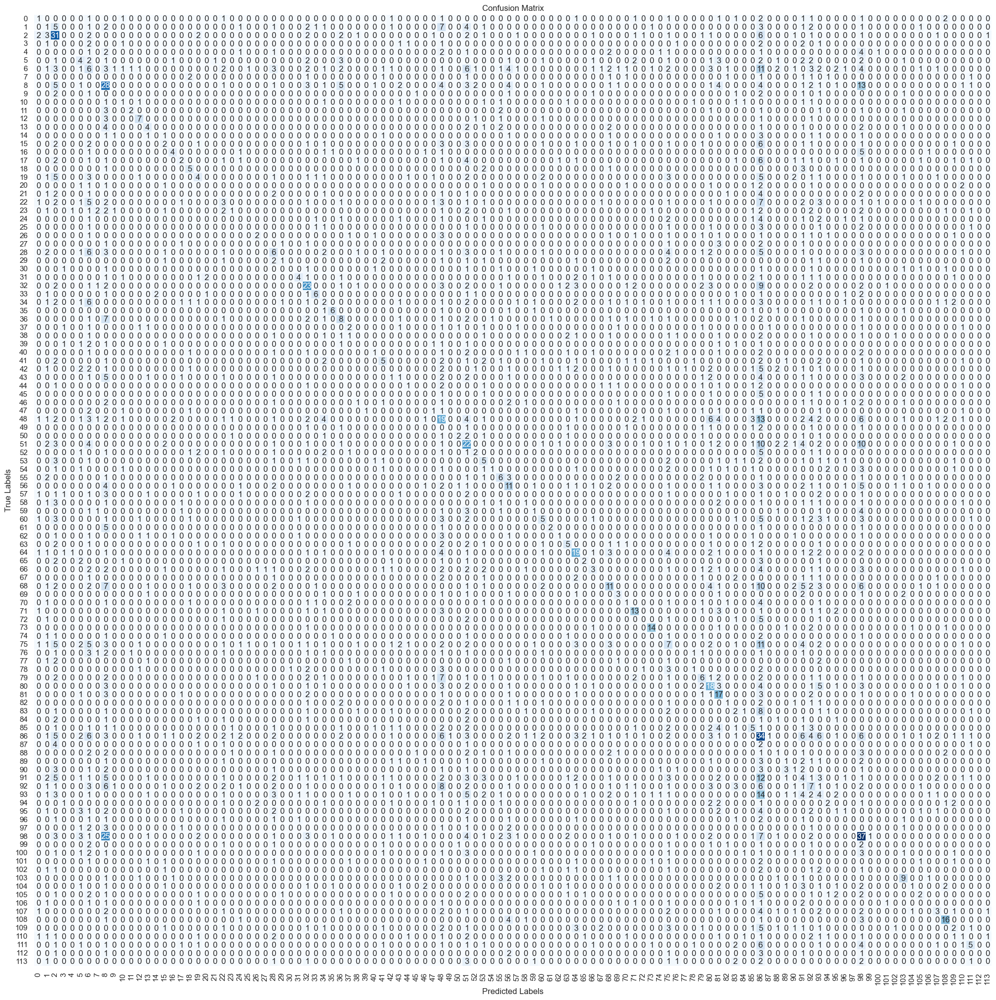

In [84]:
get_model_metrics("models/3.2/3.2_trial_{}.h5".format(study.best_trial.number), y_test, X_test_image)

102/102 [==============================] - 4s 40ms/step


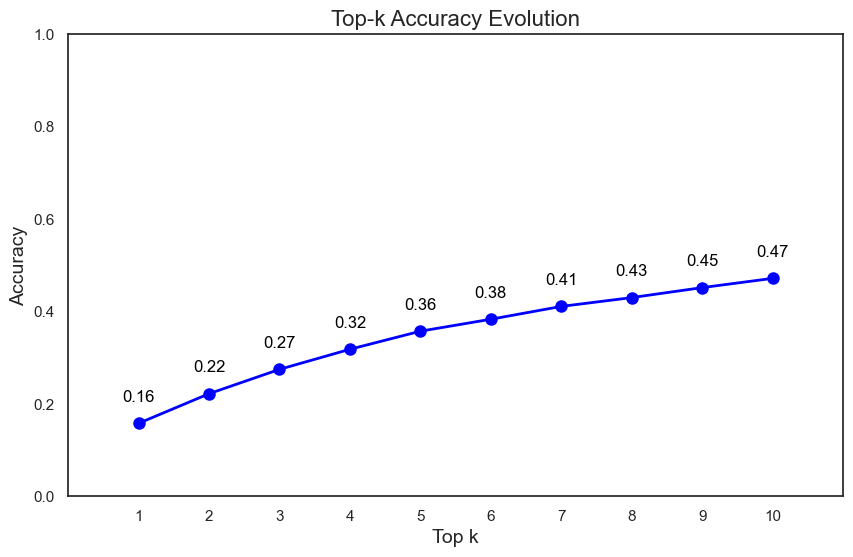

In [85]:
get_top_k_evolution_for_model("models/3.2/3.2_trial_{}.h5".format(study.best_trial.number), y_test, X_test_image)

<a id='Model-With-Functional-API'></a>
### 3.3 Model With Functional API

In [86]:
def create_model(trial):
    
    # Inputs
    image_input = Input(shape=(128, 128, 3), name='image_input')
    numerical_input = Input(shape=(1,), name='numerical_input')
    one_hot_input = Input(shape=(9,), name='one_hot_input')

    # Image processing branch
    x = Conv2D(32, (3, 3), activation='relu')(image_input)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(trial.suggest_float("dropout_rate_img", 0.1, 0.5))(x)
    x = Conv2D(64, (3, 3), activation='relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(trial.suggest_float("dropout_rate_img", 0.1, 0.5))(x)
    x = Conv2D(128, (3, 3), activation='relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(trial.suggest_float("dropout_rate_img", 0.1, 0.5))(x)
    x = Flatten()(x)

    # Numerical data processing branch
    y = Dense(trial.suggest_categorical("num_units", [16, 32, 64]), activation='relu')(numerical_input)
    y = BatchNormalization()(y)

    # One-hot encoded data processing branch
    z = Dense(trial.suggest_categorical("num_units", [16, 32, 64]), activation='relu')(one_hot_input)
    z = BatchNormalization()(z)

    # Concatenate all layers
    combined = concatenate([x, y, z])
    combined = Dense(512, activation='relu')(combined)
    combined = BatchNormalization()(combined)
    combined = Dropout(trial.suggest_float("dropout_rate_combined", 0.3, 0.7))(combined)
    output = Dense(114, activation='softmax')(combined)

    # Compile the model
    # Optimizers and learning rates to tune
    optimizer_options = ['Adam', 'SGD', 'Adagrad']
    optimizer_selected = trial.suggest_categorical('optimizer', optimizer_options)
    if optimizer_selected == 'Adam':
        optimizer = Adam(learning_rate=trial.suggest_float("adam_lr", 1e-3, 1e-2, log=True))
    elif optimizer_selected == 'SGD':
        optimizer = SGD(learning_rate=trial.suggest_float("sgd_lr", 1e-3, 1e-2, log=True))
    elif optimizer_selected == 'Adagrad':
        optimizer = Adagrad(learning_rate=trial.suggest_float("adagrad_lr", 1e-3, 1e-2, log=True))

    model = Model(inputs=[image_input, numerical_input, one_hot_input], outputs=output)
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model


def objective(trial):
    model = create_model(trial)
    model_checkpoint = ModelCheckpoint("models/3.3/3.3_trial_{}.h5".format(trial.number), monitor='val_loss', save_best_only=True, verbose=1)
    
    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.0001, verbose=1)

    # Fit the model
    history = model.fit(
        [X_train_image, X_train_numerical, X_train_one_hot], y_train,
        validation_data=([X_val_image, X_val_numerical, X_val_one_hot], y_val),
        epochs=20, verbose=0,

        # Batch size to be tuned
        batch_size=trial.suggest_categorical('batch_size', [32, 64, 128]),
        callbacks=[model_checkpoint, early_stopping, reduce_lr]
    )
    
    # Evaluate the model
    loss, accuracy = model.evaluate([X_val_image, X_val_numerical, X_val_one_hot], y_val, verbose=0)
    return accuracy

# Create the Optuna study
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=5)

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2024-04-23 21:45:41,590] A new study created in memory with name: no-name-4d0fdd2f-b67c-4f31-b4af-31e4e74b5912



Epoch 1: val_loss improved from inf to 6.58808, saving model to models/3.3\3.3_trial_0.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 6.58808 to 5.57047, saving model to models/3.3\3.3_trial_0.h5

Epoch 3: val_loss improved from 5.57047 to 4.91482, saving model to models/3.3\3.3_trial_0.h5

Epoch 4: val_loss improved from 4.91482 to 4.74983, saving model to models/3.3\3.3_trial_0.h5

Epoch 5: val_loss did not improve from 4.74983

Epoch 6: val_loss improved from 4.74983 to 4.69603, saving model to models/3.3\3.3_trial_0.h5

Epoch 7: val_loss improved from 4.69603 to 4.28989, saving model to models/3.3\3.3_trial_0.h5

Epoch 8: val_loss improved from 4.28989 to 4.20332, saving model to models/3.3\3.3_trial_0.h5

Epoch 9: val_loss did not improve from 4.20332

Epoch 10: val_loss improved from 4.20332 to 3.83071, saving model to models/3.3\3.3_trial_0.h5

Epoch 11: val_loss did not improve from 3.83071

Epoch 12: val_loss did not improve from 3.83071

Epoch 13: val_loss improved from 3.83071 to 3.66603, saving model to models/3.3\3.3_trial_0.h5

Epoch 14: val_loss improved from 3.66603 to

[I 2024-04-23 22:03:47,760] Trial 0 finished with value: 0.22595560550689697 and parameters: {'dropout_rate_img': 0.35672464810228255, 'num_units': 16, 'dropout_rate_combined': 0.499637726566429, 'optimizer': 'Adagrad', 'adagrad_lr': 0.0055407131221598795, 'batch_size': 32}. Best is trial 0 with value: 0.22595560550689697.



Epoch 1: val_loss improved from inf to 6.65266, saving model to models/3.3\3.3_trial_1.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 6.65266 to 4.18312, saving model to models/3.3\3.3_trial_1.h5

Epoch 3: val_loss improved from 4.18312 to 3.92598, saving model to models/3.3\3.3_trial_1.h5

Epoch 4: val_loss improved from 3.92598 to 3.35928, saving model to models/3.3\3.3_trial_1.h5

Epoch 5: val_loss improved from 3.35928 to 3.31747, saving model to models/3.3\3.3_trial_1.h5

Epoch 6: val_loss improved from 3.31747 to 3.17156, saving model to models/3.3\3.3_trial_1.h5

Epoch 7: val_loss improved from 3.17156 to 3.01718, saving model to models/3.3\3.3_trial_1.h5

Epoch 8: val_loss did not improve from 3.01718

Epoch 9: val_loss did not improve from 3.01718

Epoch 10: val_loss did not improve from 3.01718

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0009698552079498769.

Epoch 11: val_loss improved from 3.01718 to 2.92388, saving model to models/3.3\3.3_trial_1.h5

Epoch 12: val_loss improved from 2.92388 to 2.86426, saving model to models/3.3\3.3_trial_1.h5

Epoch 13: val_

[I 2024-04-23 22:19:27,508] Trial 1 finished with value: 0.26818743348121643 and parameters: {'dropout_rate_img': 0.3330256163981955, 'num_units': 32, 'dropout_rate_combined': 0.6188597797728834, 'optimizer': 'Adam', 'adam_lr': 0.00969855185121619, 'batch_size': 128}. Best is trial 1 with value: 0.26818743348121643.



Epoch 1: val_loss improved from inf to 5.24081, saving model to models/3.3\3.3_trial_2.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss did not improve from 5.24081

Epoch 3: val_loss did not improve from 5.24081

Epoch 4: val_loss did not improve from 5.24081

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.0005290324799716473.

Epoch 5: val_loss did not improve from 5.24081

Epoch 6: val_loss did not improve from 5.24081


[I 2024-04-23 22:24:07,692] Trial 2 finished with value: 0.008014796301722527 and parameters: {'dropout_rate_img': 0.40034164266482963, 'num_units': 32, 'dropout_rate_combined': 0.47276852345927634, 'optimizer': 'Adagrad', 'adagrad_lr': 0.005290324792394291, 'batch_size': 128}. Best is trial 1 with value: 0.26818743348121643.



Epoch 1: val_loss improved from inf to 4.97005, saving model to models/3.3\3.3_trial_3.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss did not improve from 4.97005

Epoch 3: val_loss did not improve from 4.97005

Epoch 4: val_loss did not improve from 4.97005

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.00010229534236714244.

Epoch 5: val_loss did not improve from 4.97005

Epoch 6: val_loss did not improve from 4.97005


[I 2024-04-23 22:29:39,175] Trial 3 finished with value: 0.004623921122401953 and parameters: {'dropout_rate_img': 0.22676935195741865, 'num_units': 16, 'dropout_rate_combined': 0.38022908678757744, 'optimizer': 'SGD', 'sgd_lr': 0.0010229534115257758, 'batch_size': 128}. Best is trial 1 with value: 0.26818743348121643.



Epoch 1: val_loss improved from inf to 5.31042, saving model to models/3.3\3.3_trial_4.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 5.31042 to 5.07806, saving model to models/3.3\3.3_trial_4.h5

Epoch 3: val_loss did not improve from 5.07806

Epoch 4: val_loss did not improve from 5.07806

Epoch 5: val_loss improved from 5.07806 to 4.77271, saving model to models/3.3\3.3_trial_4.h5

Epoch 6: val_loss improved from 4.77271 to 2.99000, saving model to models/3.3\3.3_trial_4.h5

Epoch 7: val_loss did not improve from 2.99000

Epoch 8: val_loss did not improve from 2.99000

Epoch 9: val_loss did not improve from 2.99000

Epoch 9: ReduceLROnPlateau reducing learning rate to 0.00011993859661743046.

Epoch 10: val_loss improved from 2.99000 to 2.93999, saving model to models/3.3\3.3_trial_4.h5

Epoch 11: val_loss did not improve from 2.93999

Epoch 12: val_loss improved from 2.93999 to 2.92943, saving model to models/3.3\3.3_trial_4.h5

Epoch 13: val_loss did not improve from 2.92943

Epoch 14: val_loss did not improve from 2.92943

Epoch 15: val_loss did not improve from 2.92943

Epoch 15

[I 2024-04-23 22:45:48,393] Trial 4 finished with value: 0.3353884220123291 and parameters: {'dropout_rate_img': 0.3969209868767607, 'num_units': 64, 'dropout_rate_combined': 0.34533649690415874, 'optimizer': 'Adam', 'adam_lr': 0.0011993859140620742, 'batch_size': 32}. Best is trial 4 with value: 0.3353884220123291.


Number of finished trials: 5
Best trial: {'dropout_rate_img': 0.3969209868767607, 'num_units': 64, 'dropout_rate_combined': 0.34533649690415874, 'optimizer': 'Adam', 'adam_lr': 0.0011993859140620742, 'batch_size': 32}


Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 image_input (InputLayer)    [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 conv2d_35 (Conv2D)          (None, 126, 126, 32)         896       ['image_input[0][0]']         
                                                                                                  
 batch_normalization_39 (Ba  (None, 126, 126, 32)         128       ['conv2d_35[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 max_pooling2d_27 (MaxPooli  (None, 63, 63, 32)           0         ['batch_normalization_39

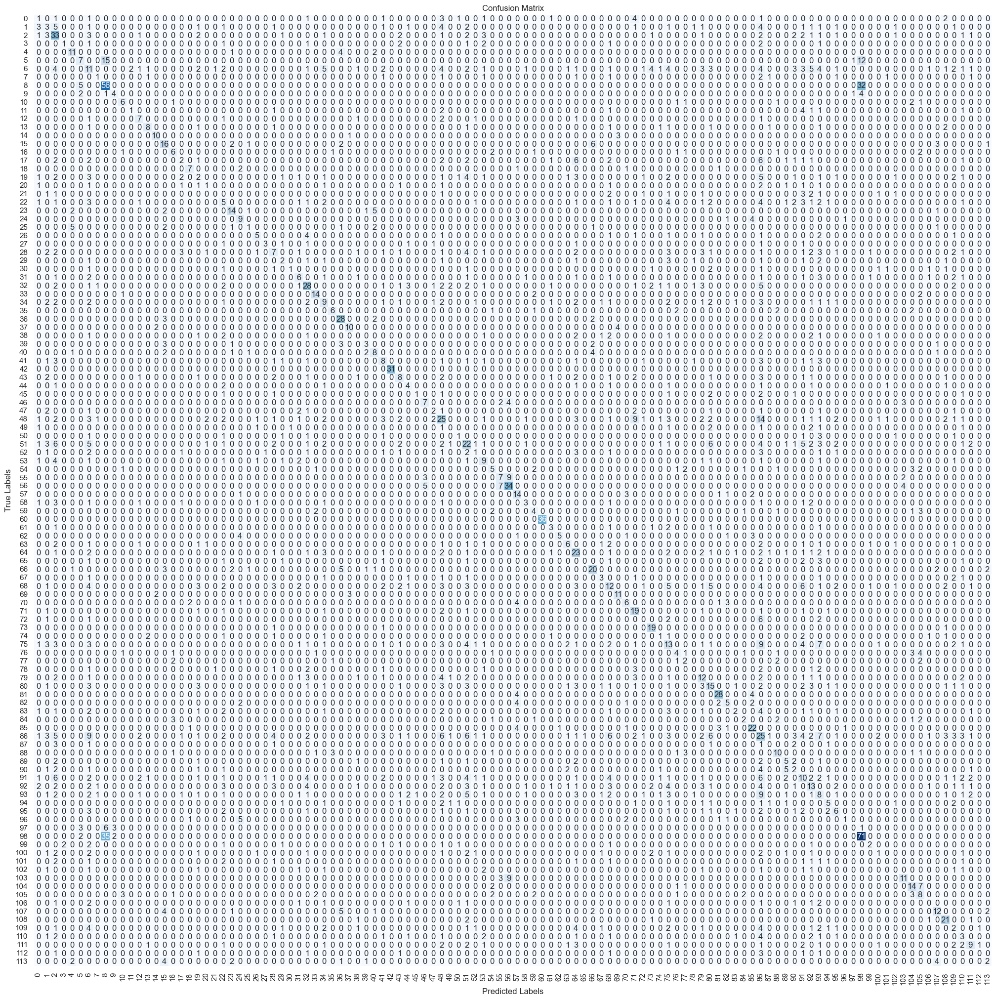

In [87]:
get_model_metrics("models/3.3/3.3_trial_{}.h5".format(study.best_trial.number), y_test, [X_test_image, X_test_numerical, X_test_one_hot], k=3)

102/102 [==============================] - 4s 40ms/step


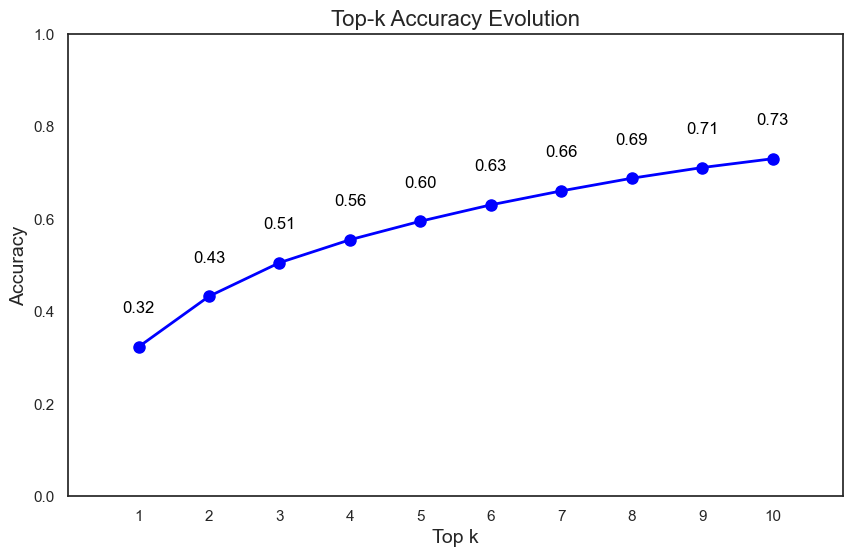

In [88]:
get_top_k_evolution_for_model("models/3.3/3.3_trial_{}.h5".format(study.best_trial.number), y_test, [X_test_image, X_test_numerical, X_test_one_hot], k_maximum=10)

<a id='Model-With-Functional-API-Augmented'></a>
### 3.4 Model With Functional API With Data Augmentation

In [89]:
def create_model(trial):
    
    # Inputs
    image_input = Input(shape=(128, 128, 3), name='image_input')
    numerical_input = Input(shape=(1,), name='numerical_input')
    one_hot_input = Input(shape=(9,), name='one_hot_input')

    # Image processing branch
    x = Conv2D(32, (3, 3), activation='relu')(image_input)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(trial.suggest_float("dropout_rate_img", 0.1, 0.5))(x)
    x = Conv2D(64, (3, 3), activation='relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(trial.suggest_float("dropout_rate_img", 0.1, 0.5))(x)
    x = Conv2D(128, (3, 3), activation='relu')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(trial.suggest_float("dropout_rate_img", 0.1, 0.5))(x)
    x = Flatten()(x)

    # Numerical data processing branch
    y = Dense(trial.suggest_categorical("num_units", [16, 32, 64]), activation='relu')(numerical_input)
    y = BatchNormalization()(y)

    # One-hot encoded data processing branch
    z = Dense(trial.suggest_categorical("num_units", [16, 32, 64]), activation='relu')(one_hot_input)
    z = BatchNormalization()(z)

    # Concatenate all layers
    combined = concatenate([x, y, z])
    combined = Dense(512, activation='relu')(combined)
    combined = BatchNormalization()(combined)
    combined = Dropout(trial.suggest_float("dropout_rate_combined", 0.3, 0.7))(combined)
    output = Dense(114, activation='softmax')(combined)

    # Compile the model
    # Optimizers and learning rates to tune
    optimizer_options = ['Adam', 'SGD', 'Adagrad']
    optimizer_selected = trial.suggest_categorical('optimizer', optimizer_options)
    if optimizer_selected == 'Adam':
        optimizer = Adam(learning_rate=trial.suggest_float("adam_lr", 1e-3, 1e-2, log=True))
    elif optimizer_selected == 'SGD':
        optimizer = SGD(learning_rate=trial.suggest_float("sgd_lr", 1e-3, 1e-2, log=True))
    elif optimizer_selected == 'Adagrad':
        optimizer = Adagrad(learning_rate=trial.suggest_float("adagrad_lr", 1e-3, 1e-2, log=True))

    model = Model(inputs=[image_input, numerical_input, one_hot_input], outputs=output)
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model

def objective(trial):
    model = create_model(trial)
    model_checkpoint = ModelCheckpoint("models/3.4/3.4_trial_{}.h5".format(trial.number), monitor='val_loss', save_best_only=True, verbose=1)
    
    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.0001, verbose=1)

    # Fit the model
    history = model.fit(
        [X_train_image_augmented, X_train_numerical_augmented, X_train_one_hot_augmented], y_train_augmented,
        validation_data=([X_val_image, X_val_numerical, X_val_one_hot], y_val),
        epochs=20, verbose=0,

        # Batch size to be tuned
        batch_size=trial.suggest_categorical('batch_size', [32, 64, 128]),
        callbacks=[model_checkpoint, early_stopping, reduce_lr]
    )
    
    # Evaluate the model
    loss, accuracy = model.evaluate([X_val_image, X_val_numerical, X_val_one_hot], y_val, verbose=0)
    return accuracy

# Create the Optuna study
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=5)

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2024-04-23 22:46:18,868] A new study created in memory with name: no-name-55178553-338c-40e4-be38-16fb4bc66844



Epoch 1: val_loss improved from inf to 5.67910, saving model to models/3.4\3.4_trial_0.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 5.67910 to 5.35555, saving model to models/3.4\3.4_trial_0.h5

Epoch 3: val_loss improved from 5.35555 to 4.50439, saving model to models/3.4\3.4_trial_0.h5

Epoch 4: val_loss did not improve from 4.50439

Epoch 5: val_loss did not improve from 4.50439

Epoch 6: val_loss did not improve from 4.50439

Epoch 6: ReduceLROnPlateau reducing learning rate to 0.0004769297782331705.

Epoch 7: val_loss improved from 4.50439 to 3.62486, saving model to models/3.4\3.4_trial_0.h5

Epoch 8: val_loss improved from 3.62486 to 3.59484, saving model to models/3.4\3.4_trial_0.h5

Epoch 9: val_loss did not improve from 3.59484

Epoch 10: val_loss improved from 3.59484 to 3.56550, saving model to models/3.4\3.4_trial_0.h5

Epoch 11: val_loss improved from 3.56550 to 3.51859, saving model to models/3.4\3.4_trial_0.h5

Epoch 12: val_loss improved from 3.51859 to 3.51186, saving model to models/3.4\3.4_trial_0.h5

Epoch 13: val_loss improved from 3.51186 to 3.51177, saving mo

[I 2024-04-23 23:35:24,061] Trial 0 finished with value: 0.23859432339668274 and parameters: {'dropout_rate_img': 0.3207529125586229, 'num_units': 64, 'dropout_rate_combined': 0.47414052099142934, 'optimizer': 'SGD', 'sgd_lr': 0.004769297566827382, 'batch_size': 64}. Best is trial 0 with value: 0.23859432339668274.



Epoch 1: val_loss improved from inf to 4.87320, saving model to models/3.4\3.4_trial_1.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 4.87320 to 4.49239, saving model to models/3.4\3.4_trial_1.h5

Epoch 3: val_loss improved from 4.49239 to 4.41028, saving model to models/3.4\3.4_trial_1.h5

Epoch 4: val_loss improved from 4.41028 to 4.35696, saving model to models/3.4\3.4_trial_1.h5

Epoch 5: val_loss improved from 4.35696 to 4.21342, saving model to models/3.4\3.4_trial_1.h5

Epoch 6: val_loss did not improve from 4.21342

Epoch 7: val_loss did not improve from 4.21342

Epoch 8: val_loss improved from 4.21342 to 4.06520, saving model to models/3.4\3.4_trial_1.h5

Epoch 9: val_loss did not improve from 4.06520

Epoch 10: val_loss improved from 4.06520 to 3.99141, saving model to models/3.4\3.4_trial_1.h5

Epoch 11: val_loss did not improve from 3.99141

Epoch 12: val_loss did not improve from 3.99141

Epoch 13: val_loss did not improve from 3.99141

Epoch 13: ReduceLROnPlateau reducing learning rate to 0.00011296834563836456.

Epoch 14: val_loss improved from 3.99141 to 3.85962, savin

[I 2024-04-24 00:23:50,508] Trial 1 finished with value: 0.1704685539007187 and parameters: {'dropout_rate_img': 0.11710843041855018, 'num_units': 16, 'dropout_rate_combined': 0.5085645467480351, 'optimizer': 'SGD', 'sgd_lr': 0.0011296834002445365, 'batch_size': 64}. Best is trial 0 with value: 0.23859432339668274.



Epoch 1: val_loss improved from inf to 7.38643, saving model to models/3.4\3.4_trial_2.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 7.38643 to 6.87543, saving model to models/3.4\3.4_trial_2.h5

Epoch 3: val_loss improved from 6.87543 to 6.68529, saving model to models/3.4\3.4_trial_2.h5

Epoch 4: val_loss improved from 6.68529 to 5.52478, saving model to models/3.4\3.4_trial_2.h5

Epoch 5: val_loss improved from 5.52478 to 4.75592, saving model to models/3.4\3.4_trial_2.h5

Epoch 6: val_loss did not improve from 4.75592

Epoch 7: val_loss improved from 4.75592 to 4.56597, saving model to models/3.4\3.4_trial_2.h5

Epoch 8: val_loss improved from 4.56597 to 4.40689, saving model to models/3.4\3.4_trial_2.h5

Epoch 9: val_loss improved from 4.40689 to 4.29676, saving model to models/3.4\3.4_trial_2.h5

Epoch 10: val_loss improved from 4.29676 to 4.08680, saving model to models/3.4\3.4_trial_2.h5

Epoch 11: val_loss improved from 4.08680 to 3.97784, saving model to models/3.4\3.4_trial_2.h5

Epoch 12: val_loss improved from 3.97784 to 3.79927, saving model to models/3.4\3.4_trial_2.h5

[I 2024-04-24 01:12:05,579] Trial 2 finished with value: 0.23304562270641327 and parameters: {'dropout_rate_img': 0.47384061148191603, 'num_units': 16, 'dropout_rate_combined': 0.4766544846941221, 'optimizer': 'Adagrad', 'adagrad_lr': 0.0047414299479303845, 'batch_size': 128}. Best is trial 0 with value: 0.23859432339668274.



Epoch 1: val_loss improved from inf to 5.63610, saving model to models/3.4\3.4_trial_3.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss did not improve from 5.63610

Epoch 3: val_loss did not improve from 5.63610

Epoch 4: val_loss improved from 5.63610 to 4.95788, saving model to models/3.4\3.4_trial_3.h5

Epoch 5: val_loss did not improve from 4.95788

Epoch 6: val_loss did not improve from 4.95788

Epoch 7: val_loss improved from 4.95788 to 3.70001, saving model to models/3.4\3.4_trial_3.h5

Epoch 8: val_loss improved from 3.70001 to 3.57967, saving model to models/3.4\3.4_trial_3.h5

Epoch 9: val_loss did not improve from 3.57967

Epoch 10: val_loss improved from 3.57967 to 3.32113, saving model to models/3.4\3.4_trial_3.h5

Epoch 11: val_loss did not improve from 3.32113

Epoch 12: val_loss improved from 3.32113 to 3.17869, saving model to models/3.4\3.4_trial_3.h5

Epoch 13: val_loss improved from 3.17869 to 3.05086, saving model to models/3.4\3.4_trial_3.h5

Epoch 14: val_loss improved from 3.05086 to 2.95868, saving model to models/3.4\3.4_trial_3.h5

Epoch 15: val_loss improved from 2.95868 

[I 2024-04-24 02:05:07,384] Trial 3 finished with value: 0.30641183257102966 and parameters: {'dropout_rate_img': 0.2894478878075063, 'num_units': 32, 'dropout_rate_combined': 0.6581665856957586, 'optimizer': 'SGD', 'sgd_lr': 0.006366403911225551, 'batch_size': 32}. Best is trial 3 with value: 0.30641183257102966.



Epoch 1: val_loss improved from inf to 4.22024, saving model to models/3.4\3.4_trial_4.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 4.22024 to 3.05384, saving model to models/3.4\3.4_trial_4.h5

Epoch 3: val_loss improved from 3.05384 to 3.00027, saving model to models/3.4\3.4_trial_4.h5

Epoch 4: val_loss improved from 3.00027 to 2.94462, saving model to models/3.4\3.4_trial_4.h5

Epoch 5: val_loss improved from 2.94462 to 2.90067, saving model to models/3.4\3.4_trial_4.h5

Epoch 6: val_loss did not improve from 2.90067

Epoch 7: val_loss did not improve from 2.90067

Epoch 8: val_loss did not improve from 2.90067

Epoch 8: ReduceLROnPlateau reducing learning rate to 0.0004253738094121218.

Epoch 9: val_loss improved from 2.90067 to 2.67215, saving model to models/3.4\3.4_trial_4.h5

Epoch 10: val_loss improved from 2.67215 to 2.66270, saving model to models/3.4\3.4_trial_4.h5

Epoch 11: val_loss improved from 2.66270 to 2.64678, saving model to models/3.4\3.4_trial_4.h5

Epoch 12: val_loss did not improve from 2.64678

Epoch 13: val_loss did not improve from 2.64678

Epoch 14: val

[I 2024-04-24 02:47:45,578] Trial 4 finished with value: 0.3409371078014374 and parameters: {'dropout_rate_img': 0.33846602232096573, 'num_units': 64, 'dropout_rate_combined': 0.668798647763459, 'optimizer': 'Adam', 'adam_lr': 0.004253738267116145, 'batch_size': 64}. Best is trial 4 with value: 0.3409371078014374.


Number of finished trials: 5
Best trial: {'dropout_rate_img': 0.33846602232096573, 'num_units': 64, 'dropout_rate_combined': 0.668798647763459, 'optimizer': 'Adam', 'adam_lr': 0.004253738267116145, 'batch_size': 64}


Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 image_input (InputLayer)    [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 conv2d_50 (Conv2D)          (None, 126, 126, 32)         896       ['image_input[0][0]']         
                                                                                                  
 batch_normalization_69 (Ba  (None, 126, 126, 32)         128       ['conv2d_50[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 max_pooling2d_42 (MaxPooli  (None, 63, 63, 32)           0         ['batch_normalization_69

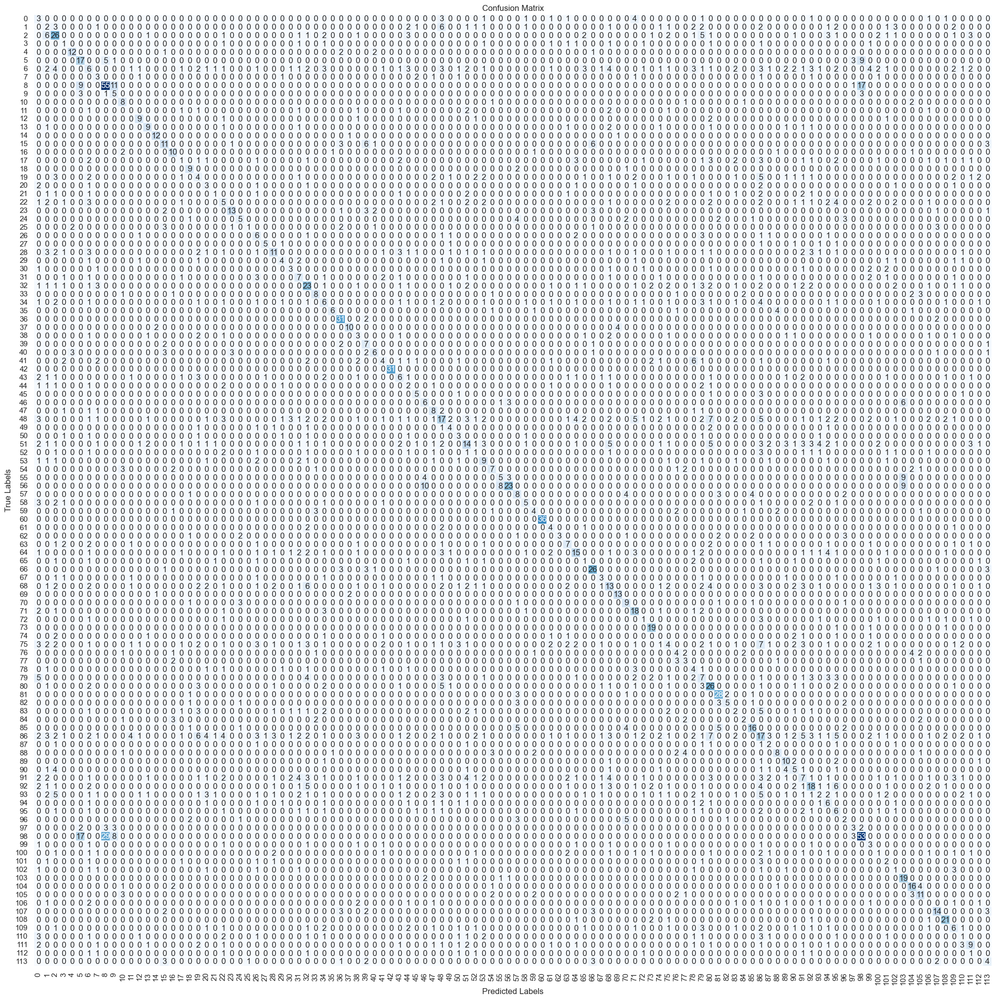

In [90]:
get_model_metrics("models/3.4/3.4_trial_{}.h5".format(study.best_trial.number), y_test, [X_test_image, X_test_numerical, X_test_one_hot], k=3)

102/102 [==============================] - 4s 41ms/step


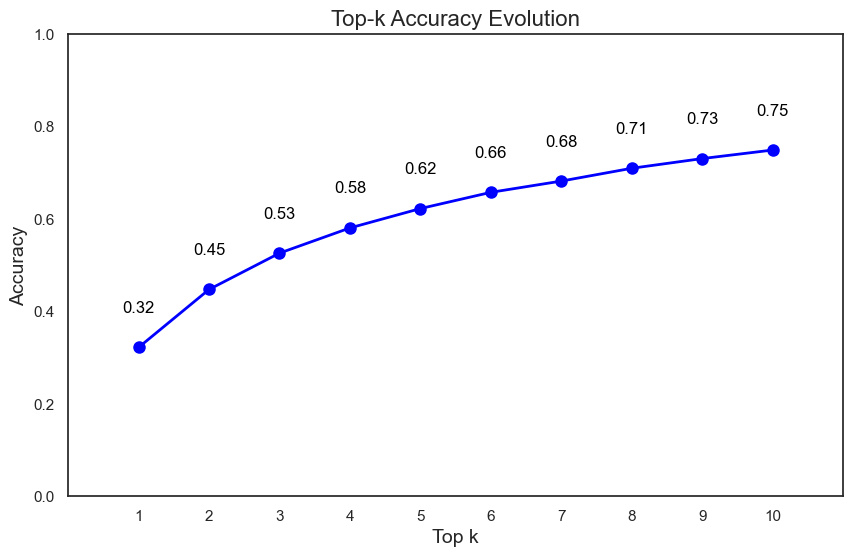

In [91]:
get_top_k_evolution_for_model("models/3.4/3.4_trial_{}.h5".format(study.best_trial.number), y_test, [X_test_image, X_test_numerical, X_test_one_hot], k_maximum=10)

<a id='Transfer-Learnign-Without-Functional-API'></a>
### 3.5 Transfer Learning Without Functional API Without Data Augmentation

#### **VGG 16**

In [92]:
# Load the VGG16 model pretrained on ImageNet without the top fully connected layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

# Display the architecture of the base model to decide from which layer to start unfreezing
base_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 128, 128, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 128, 128, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 64, 64, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 64, 64, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 64, 64, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 32, 32, 128)       0     

In [93]:
def create_model(trial):
    
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=(128, 128, 3))

    # Unfreeze from the 7th layer onwards
    for i in range(len(base_model.layers)):
       if i >= 7:
           base_model.layers[i].trainable = True
       else:
           base_model.layers[i].trainable = False
        
    x = Flatten()(base_model.output)

    predictions = Dense(114, activation='softmax')(x)

    # Optimizers to tune
    optimizer_options = ['Adam', 'SGD', 'Adagrad']
    optimizer_selected = trial.suggest_categorical('optimizer', optimizer_options)

    # Learning rates to tune
    learning_rate = trial.suggest_float("learning_rate", 1e-3, 1e-2, log=True)
    
    if optimizer_selected == 'Adam':
        optimizer = Adam(learning_rate=learning_rate)
    elif optimizer_selected == 'SGD':
        optimizer = SGD(learning_rate=learning_rate)
    elif optimizer_selected == 'Adagrad':
        optimizer = Adagrad(learning_rate=learning_rate)
    
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model


def objective(trial):
    
    model = create_model(trial)
    model_checkpoint = ModelCheckpoint("models/3.5/3.5_vgg_trial_{}.h5".format(trial.number), monitor='val_loss', save_best_only=True, verbose=1)

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.0001, verbose=1)

    # Fit the model
    history = model.fit(
        x=X_train_image, 
        y=y_train,
        validation_data=(X_val_image, y_val),
        epochs=20,  

        # Batch size to be tuned
        batch_size=trial.suggest_categorical('batch_size', [16, 32, 64]),
        callbacks=[model_checkpoint, early_stopping, reduce_lr],
        verbose=0
    )

    # Evaluate the model
    loss, accuracy = model.evaluate(X_val_image, y_val, verbose=0)
    return accuracy

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=4)

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2024-04-24 02:48:18,926] A new study created in memory with name: no-name-9ba2b16b-9145-4bd9-baf8-625328f340bc



Epoch 1: val_loss improved from inf to 4.47891, saving model to models/3.5\3.5_vgg_trial_0.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 4.47891 to 4.01705, saving model to models/3.5\3.5_vgg_trial_0.h5

Epoch 3: val_loss improved from 4.01705 to 3.93249, saving model to models/3.5\3.5_vgg_trial_0.h5

Epoch 4: val_loss improved from 3.93249 to 3.60489, saving model to models/3.5\3.5_vgg_trial_0.h5

Epoch 5: val_loss did not improve from 3.60489

Epoch 6: val_loss did not improve from 3.60489

Epoch 7: val_loss did not improve from 3.60489

Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0002306936075910926.

Epoch 8: val_loss did not improve from 3.60489

Epoch 9: val_loss did not improve from 3.60489


[I 2024-04-24 03:59:46,995] Trial 0 finished with value: 0.19266337156295776 and parameters: {'optimizer': 'SGD', 'learning_rate': 0.0023069361678928783, 'batch_size': 16}. Best is trial 0 with value: 0.19266337156295776.



Epoch 1: val_loss improved from inf to 4.42134, saving model to models/3.5\3.5_vgg_trial_1.h5

Epoch 2: val_loss improved from 4.42134 to 4.41729, saving model to models/3.5\3.5_vgg_trial_1.h5

Epoch 3: val_loss did not improve from 4.41729

Epoch 4: val_loss did not improve from 4.41729

Epoch 5: val_loss did not improve from 4.41729

Epoch 5: ReduceLROnPlateau reducing learning rate to 0.0001439871732145548.

Epoch 6: val_loss improved from 4.41729 to 3.58679, saving model to models/3.5\3.5_vgg_trial_1.h5

Epoch 7: val_loss did not improve from 3.58679

Epoch 8: val_loss did not improve from 3.58679

Epoch 9: val_loss did not improve from 3.58679

Epoch 9: ReduceLROnPlateau reducing learning rate to 0.0001.

Epoch 10: val_loss did not improve from 3.58679

Epoch 11: val_loss did not improve from 3.58679


[I 2024-04-24 05:21:53,809] Trial 1 finished with value: 0.21393340826034546 and parameters: {'optimizer': 'Adagrad', 'learning_rate': 0.0014398717825754353, 'batch_size': 64}. Best is trial 1 with value: 0.21393340826034546.



Epoch 1: val_loss improved from inf to 4.56817, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 2: val_loss improved from 4.56817 to 4.51561, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 3: val_loss improved from 4.51561 to 4.50397, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 4: val_loss improved from 4.50397 to 4.50160, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 5: val_loss improved from 4.50160 to 4.50107, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 6: val_loss improved from 4.50107 to 4.50098, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 7: val_loss improved from 4.50098 to 4.50093, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 8: val_loss improved from 4.50093 to 4.50090, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 9: val_loss improved from 4.50090 to 4.50088, saving model to models/3.5\3.5_vgg_trial_2.h5

Epoch 10: val_loss did not improve from 4.50088

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0003078

[I 2024-04-24 07:59:12,869] Trial 2 finished with value: 0.039765723049640656 and parameters: {'optimizer': 'Adam', 'learning_rate': 0.003078174829274778, 'batch_size': 16}. Best is trial 1 with value: 0.21393340826034546.



Epoch 1: val_loss improved from inf to 4.68906, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 2: val_loss improved from 4.68906 to 4.61184, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 3: val_loss improved from 4.61184 to 4.56362, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 4: val_loss improved from 4.56362 to 4.53481, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 5: val_loss improved from 4.53481 to 4.51875, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 6: val_loss improved from 4.51875 to 4.51000, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 7: val_loss improved from 4.51000 to 4.50543, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 8: val_loss improved from 4.50543 to 4.50313, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 9: val_loss improved from 4.50313 to 4.50197, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 10: val_loss improved from 4.50197 to 4.50147, saving model to models/3.5\3.5_vgg_trial_3.h5

Epoch 11: va

[I 2024-04-24 10:21:44,746] Trial 3 finished with value: 0.039765723049640656 and parameters: {'optimizer': 'Adam', 'learning_rate': 0.003074906098897136, 'batch_size': 64}. Best is trial 1 with value: 0.21393340826034546.


Number of finished trials: 4
Best trial: {'optimizer': 'Adagrad', 'learning_rate': 0.0014398717825754353, 'batch_size': 64}


Model: "model_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 128, 128, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 128, 128, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 64, 64, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 64, 64, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 64, 64, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 32, 32, 128)       0  

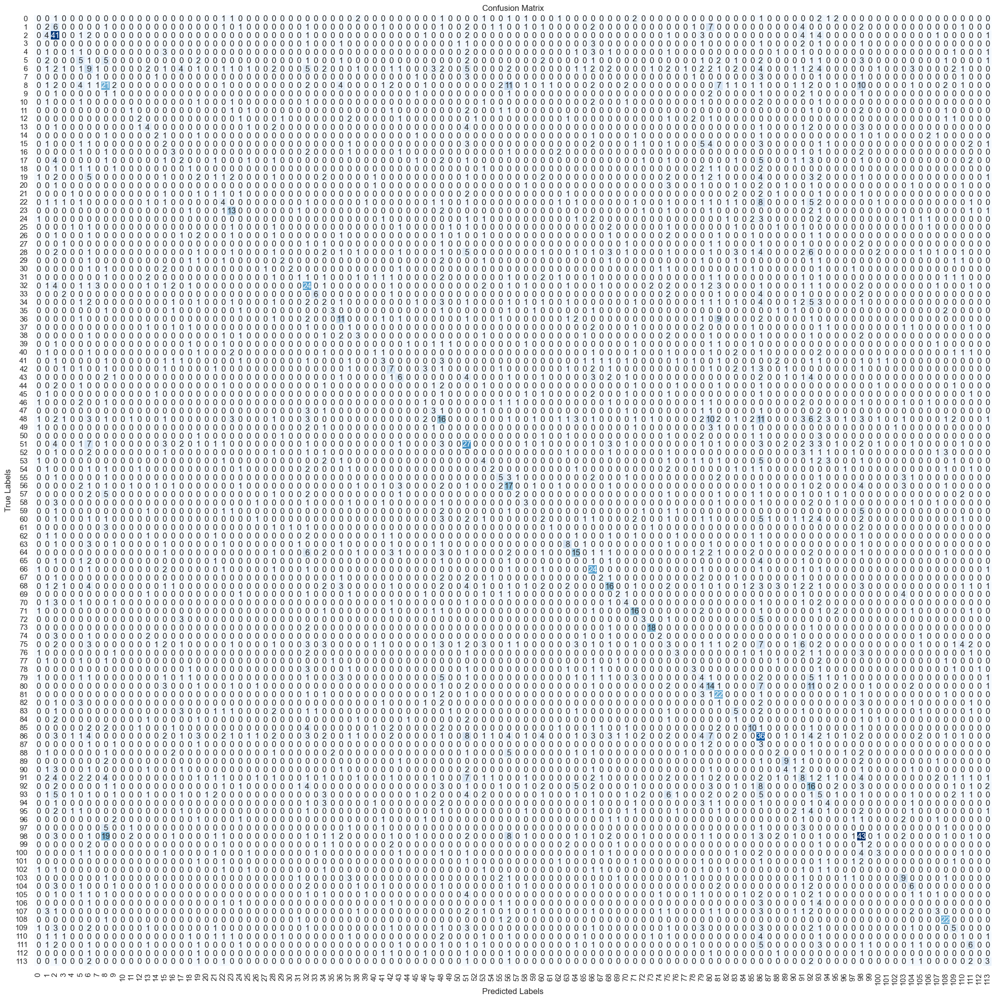

In [94]:
get_model_metrics("models/3.5/3.5_vgg_trial_{}.h5".format(study.best_trial.number), y_test, X_test_image, k=3)

102/102 [==============================] - 47s 457ms/step


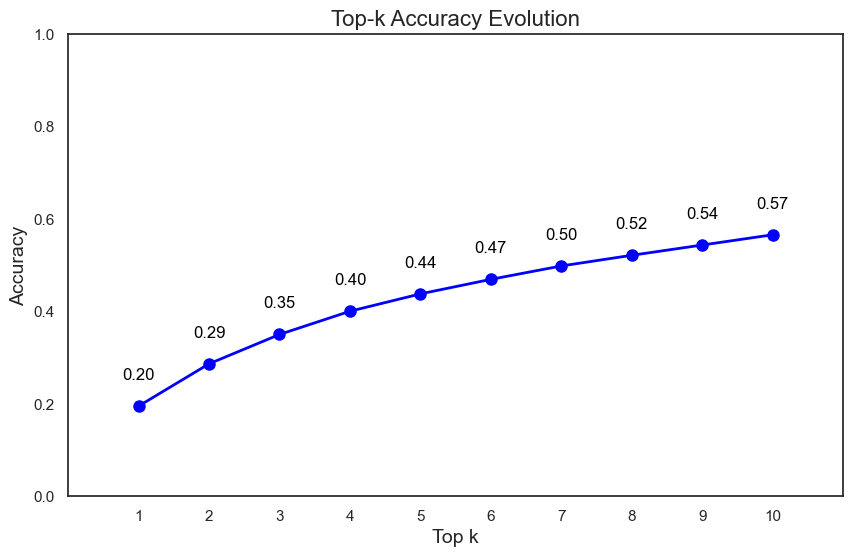

In [95]:
get_top_k_evolution_for_model("models/3.5/3.5_vgg_trial_{}.h5".format(study.best_trial.number), y_test, X_test_image, k_maximum=10)

#### **Dense Net**

In [58]:
# Load the DenseNet201 model pretrained on ImageNet without the top fully connected layers
base_model = DenseNet201(include_top=False, weights="imagenet", input_shape=(128, 128, 3))

# Initialize a flag to control the freezing process
flag = False

# Iterate through all layers of the model
for i in range(len(base_model.layers)):
    
    layer = base_model.layers[i]  # Get the layer at the current index
    
    # Check if the current layer is 'conv5_block30_0_bn' or if the flag has been activated
    if layer.name == 'conv5_block30_0_bn' or flag:
        print("unfreezing ", layer.name)  # Indicate that the layer is being unfrozen
        flag = True  # Set the flag to True to unfreeze this and all subsequent layers
        base_model.layers[i].trainable = True  # Allow the layer to be trainable
    else:
        print("freezing ", layer.name)  # Indicate that the layer is being frozen
        base_model.layers[i].trainable = False  # Set the layer to be non-trainable

# Display the architecture of the model
# This summary will show which layers are trainable after the above modifications
base_model.summary()

freezing  input_1
freezing  zero_padding2d
freezing  conv1/conv
freezing  conv1/bn
freezing  conv1/relu
freezing  zero_padding2d_1
freezing  pool1
freezing  conv2_block1_0_bn
freezing  conv2_block1_0_relu
freezing  conv2_block1_1_conv
freezing  conv2_block1_1_bn
freezing  conv2_block1_1_relu
freezing  conv2_block1_2_conv
freezing  conv2_block1_concat
freezing  conv2_block2_0_bn
freezing  conv2_block2_0_relu
freezing  conv2_block2_1_conv
freezing  conv2_block2_1_bn
freezing  conv2_block2_1_relu
freezing  conv2_block2_2_conv
freezing  conv2_block2_concat
freezing  conv2_block3_0_bn
freezing  conv2_block3_0_relu
freezing  conv2_block3_1_conv
freezing  conv2_block3_1_bn
freezing  conv2_block3_1_relu
freezing  conv2_block3_2_conv
freezing  conv2_block3_concat
freezing  conv2_block4_0_bn
freezing  conv2_block4_0_relu
freezing  conv2_block4_1_conv
freezing  conv2_block4_1_bn
freezing  conv2_block4_1_relu
freezing  conv2_block4_2_conv
freezing  conv2_block4_concat
freezing  conv2_block5_0_bn
f

In [59]:
def create_model(trial):
    
    # Add custom top layers
    x = GlobalMaxPooling2D()(base_model.output)
    predictions = Dense(114, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)

    # Optimizers to tune
    optimizer_options = ['Adam', 'SGD', 'Adagrad']
    optimizer_selected = trial.suggest_categorical('optimizer', optimizer_options)

    # Learning rates to tune
    learning_rate = trial.suggest_float("lr", 1e-3, 1e-2, log=True)
    optimizer = {
        'Adam': Adam(learning_rate=learning_rate),
        'SGD': SGD(learning_rate=learning_rate), 
        'Adagrad': Adagrad(learning_rate=learning_rate)
    }[optimizer_selected]

    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model


def objective(trial):
    model = create_model(trial)
    model_checkpoint = ModelCheckpoint("models/3.5/3.5_dense_net_trial_{}".format(trial.number), monitor='val_loss', save_best_only=True, verbose=1)

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.0001, verbose=1)

    # Fit the model
    history = model.fit(
        x=X_train_image, y=y_train,
        validation_data=(X_val_image, y_val),
        epochs=20, 

        # Batch size to be tuned
        batch_size=trial.suggest_categorical('batch_size', [16, 32, 64]),
        callbacks=[model_checkpoint, early_stopping, reduce_lr],
        verbose=0
    )

    # Evaluate the model
    loss, accuracy = model.evaluate(X_val_image, y_val, verbose=0)
    return accuracy

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=4)

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2024-04-26 00:10:46,443] A new study created in memory with name: no-name-5b038437-04e0-4f9d-aee4-b91c4f8bb5ce





Epoch 1: val_loss improved from inf to 5.55044, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 2: val_loss improved from 5.55044 to 5.28996, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 3: val_loss improved from 5.28996 to 5.05575, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 4: val_loss improved from 5.05575 to 4.92006, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 5: val_loss improved from 4.92006 to 4.80423, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 6: val_loss improved from 4.80423 to 4.61532, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 7: val_loss improved from 4.61532 to 4.51408, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 8: val_loss improved from 4.51408 to 4.41814, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 9: val_loss improved from 4.41814 to 4.36792, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 10: val_loss improved from 4.36792 to 4.30143, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 11: val_loss improved from 4.30143 to 4.25076, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 12: val_loss improved from 4.25076 to 4.16871, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 13: val_loss improved from 4.16871 to 4.14793, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 14: val_loss improved from 4.14793 to 4.08164, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 15: val_loss improved from 4.08164 to 4.07162, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 16: val_loss improved from 4.07162 to 3.99498, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 17: val_loss improved from 3.99498 to 3.95765, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 18: val_loss did not improve from 3.95765

Epoch 19: val_loss improved from 3.95765 to 3.92244, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets



Epoch 20: val_loss improved from 3.92244 to 3.88858, saving model to models/3.5\3.5_dense_net_trial_0
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_0\assets
[I 2024-04-26 01:11:24,019] Trial 0 finished with value: 0.18896424770355225 and parameters: {'optimizer': 'SGD', 'lr': 0.0012295817715935438, 'batch_size': 64}. Best is trial 0 with value: 0.18896424770355225.



Epoch 1: val_loss improved from inf to 4.79653, saving model to models/3.5\3.5_dense_net_trial_1
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets



Epoch 2: val_loss improved from 4.79653 to 4.60574, saving model to models/3.5\3.5_dense_net_trial_1
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets



Epoch 3: val_loss improved from 4.60574 to 4.40664, saving model to models/3.5\3.5_dense_net_trial_1
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets



Epoch 4: val_loss did not improve from 4.40664

Epoch 5: val_loss did not improve from 4.40664

Epoch 6: val_loss did not improve from 4.40664

Epoch 6: ReduceLROnPlateau reducing learning rate to 0.00029860169161111116.

Epoch 7: val_loss improved from 4.40664 to 3.88716, saving model to models/3.5\3.5_dense_net_trial_1
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets



Epoch 8: val_loss improved from 3.88716 to 3.86958, saving model to models/3.5\3.5_dense_net_trial_1
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets



Epoch 9: val_loss improved from 3.86958 to 3.85702, saving model to models/3.5\3.5_dense_net_trial_1
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_1\assets



Epoch 10: val_loss did not improve from 3.85702

Epoch 11: val_loss did not improve from 3.85702

Epoch 12: val_loss did not improve from 3.85702

Epoch 12: ReduceLROnPlateau reducing learning rate to 0.0001.

Epoch 13: val_loss did not improve from 3.85702

Epoch 14: val_loss did not improve from 3.85702


[I 2024-04-26 01:47:02,774] Trial 1 finished with value: 0.3292231857776642 and parameters: {'optimizer': 'Adam', 'lr': 0.0029860168391298327, 'batch_size': 64}. Best is trial 1 with value: 0.3292231857776642.



Epoch 1: val_loss improved from inf to 4.38016, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 2: val_loss improved from 4.38016 to 4.04302, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 3: val_loss improved from 4.04302 to 3.77598, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 4: val_loss improved from 3.77598 to 3.61514, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 5: val_loss improved from 3.61514 to 3.49330, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 6: val_loss improved from 3.49330 to 3.42730, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 7: val_loss improved from 3.42730 to 3.38173, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 8: val_loss improved from 3.38173 to 3.30437, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 9: val_loss did not improve from 3.30437

Epoch 10: val_loss improved from 3.30437 to 3.25660, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 11: val_loss did not improve from 3.25660

Epoch 12: val_loss improved from 3.25660 to 3.21578, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 13: val_loss improved from 3.21578 to 3.18766, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 14: val_loss did not improve from 3.18766

Epoch 15: val_loss did not improve from 3.18766

Epoch 16: val_loss did not improve from 3.18766

Epoch 16: ReduceLROnPlateau reducing learning rate to 0.00041360314935445786.

Epoch 17: val_loss improved from 3.18766 to 3.15134, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 18: val_loss improved from 3.15134 to 3.14083, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 19: val_loss improved from 3.14083 to 3.13505, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets



Epoch 20: val_loss improved from 3.13505 to 3.13268, saving model to models/3.5\3.5_dense_net_trial_2
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_2\assets
[I 2024-04-26 02:44:31,213] Trial 2 finished with value: 0.30363747477531433 and parameters: {'optimizer': 'Adagrad', 'lr': 0.004136031453383675, 'batch_size': 64}. Best is trial 1 with value: 0.3292231857776642.



Epoch 1: val_loss improved from inf to 4.06343, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 2: val_loss improved from 4.06343 to 3.71311, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 3: val_loss improved from 3.71311 to 3.59353, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 4: val_loss improved from 3.59353 to 3.56067, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 5: val_loss improved from 3.56067 to 3.41589, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 6: val_loss did not improve from 3.41589

Epoch 7: val_loss did not improve from 3.41589

Epoch 8: val_loss did not improve from 3.41589

Epoch 8: ReduceLROnPlateau reducing learning rate to 0.0003462985390797258.

Epoch 9: val_loss improved from 3.41589 to 3.31143, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 10: val_loss did not improve from 3.31143

Epoch 11: val_loss improved from 3.31143 to 3.30939, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 12: val_loss did not improve from 3.30939

Epoch 13: val_loss did not improve from 3.30939

Epoch 14: val_loss did not improve from 3.30939

Epoch 14: ReduceLROnPlateau reducing learning rate to 0.0001.

Epoch 15: val_loss improved from 3.30939 to 3.30904, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 16: val_loss improved from 3.30904 to 3.30744, saving model to models/3.5\3.5_dense_net_trial_3
INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets


INFO:tensorflow:Assets written to: models/3.5\3.5_dense_net_trial_3\assets



Epoch 17: val_loss did not improve from 3.30744

Epoch 18: val_loss did not improve from 3.30744

Epoch 19: val_loss did not improve from 3.30744

Epoch 20: val_loss did not improve from 3.30744


[I 2024-04-26 03:51:23,352] Trial 3 finished with value: 0.319975346326828 and parameters: {'optimizer': 'SGD', 'lr': 0.0034629852987262907, 'batch_size': 16}. Best is trial 1 with value: 0.3292231857776642.


Number of finished trials: 4
Best trial: {'optimizer': 'Adam', 'lr': 0.0029860168391298327, 'batch_size': 64}


Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 134, 134, 3)          0         ['input_1[0][0]']             
 g2D)                                                                                             
                                                                                                  
 conv1/conv (Conv2D)         (None, 64, 64, 64)           9408      ['zero_padding2d[0][0]']      
                                                                                                  
 conv1/bn (BatchNormalizati  (None, 64, 64, 64)           256       ['conv1/conv[0][0]']    

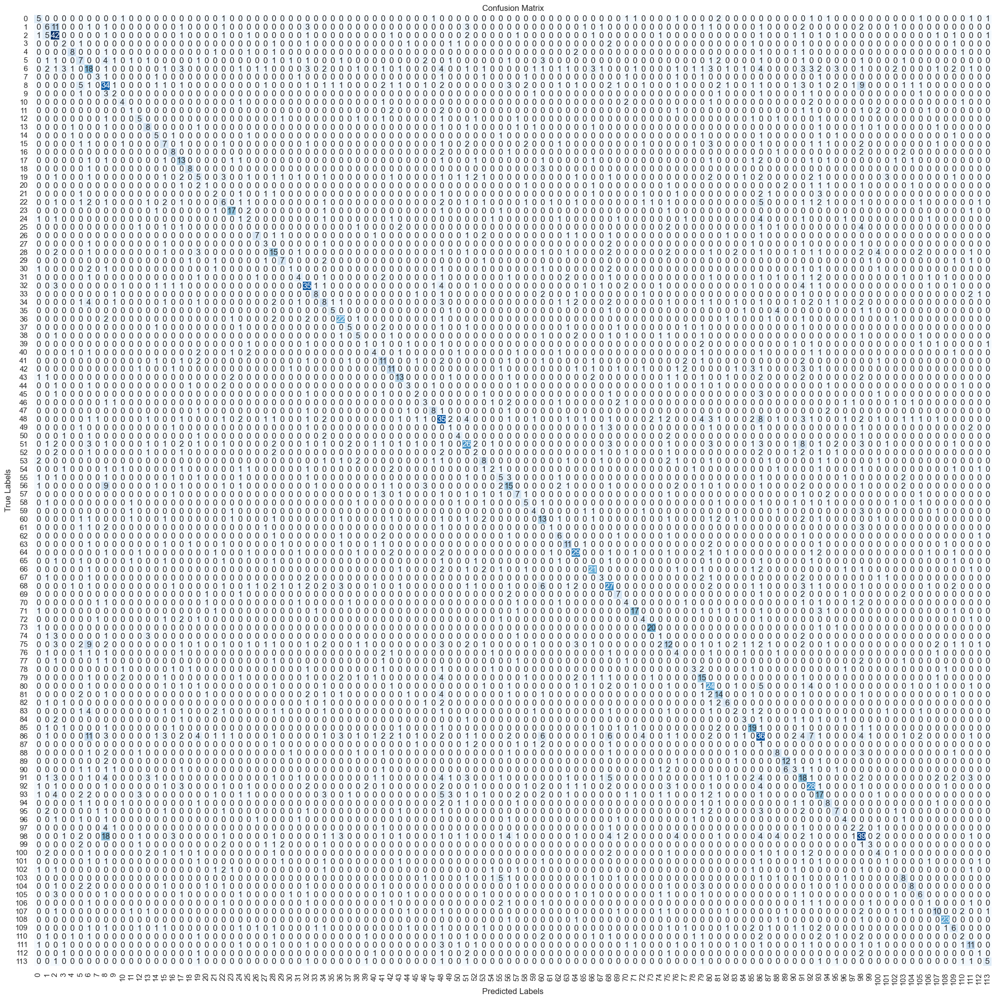

In [60]:
get_model_metrics("models/3.5/3.5_dense_net_trial_{}".format(study.best_trial.number), y_test, X_test_image, k=3)

102/102 [==============================] - 36s 320ms/step


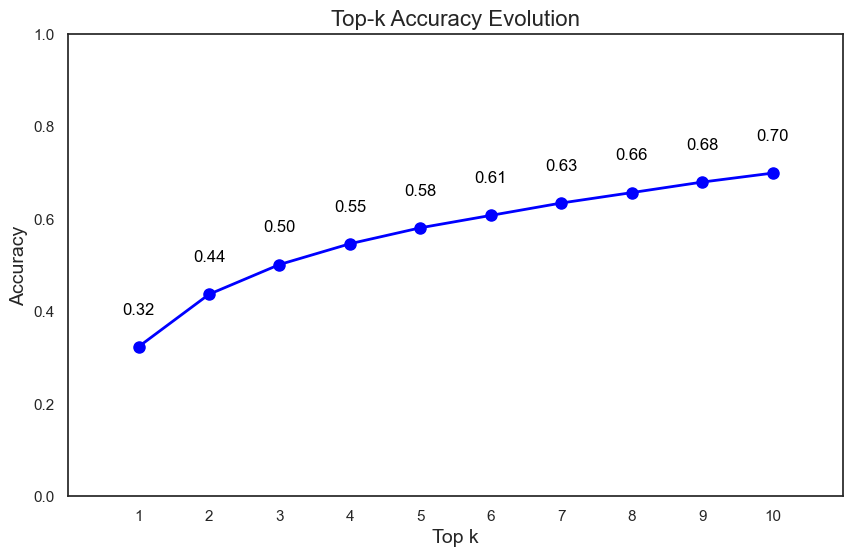

In [61]:
get_top_k_evolution_for_model("models/3.5/3.5_dense_net_trial_{}".format(study.best_trial.number), y_test, X_test_image, k_maximum=10)

<a id='Transfer-Learning-With-Functional-API'></a>
### 3.6 Transfer Learning With Functional API With Data Augmentation

#### **Dense Net**

In [57]:
def create_model(trial):
    
    # Inputs
    image_input = Input(shape=(128, 128, 3), name='image_input')
    numerical_input = Input(shape=(1,), name='numerical_input')
    one_hot_input = Input(shape=(9,), name='one_hot_input')

    # DenseNet201-based image processing branch
    base_model = DenseNet201(include_top=False, weights="imagenet", input_tensor=image_input)

    # Only train layers after 'conv5_block30_0_bn'
    flag = False
    for layer in base_model.layers:
        if layer.name == 'conv5_block30_0_bn' or flag:
            layer.trainable = True
            flag = True
        else:
            layer.trainable = False

    x = GlobalAveragePooling2D()(base_model.output)
    x = BatchNormalization()(x)
    x = Dropout(trial.suggest_float("dropout_rate", 0.3, 0.5))(x)

    # Numerical data processing branch
    y = Dense(trial.suggest_categorical("num_units", [16, 32, 64]), activation='relu')(numerical_input)
    y = BatchNormalization()(y)

    # One-hot encoded data processing branch
    z = Dense(trial.suggest_categorical("num_units_one_hot", [16, 32, 64]), activation='relu')(one_hot_input)
    z = BatchNormalization()(z)

    # Concatenate all layers
    combined = concatenate([x, y, z])
    combined = Dense(512, activation='relu')(combined)
    combined = BatchNormalization()(combined)
    combined = Dropout(trial.suggest_float("dropout_rate_combined", 0.3, 0.7))(combined)
    output = Dense(114, activation='softmax')(combined)

    # Compile the model
    # Optimizers to tune
    optimizer_options = ['Adam', 'SGD', 'Adagrad']
    optimizer_selected = trial.suggest_categorical('optimizer', optimizer_options)

    # Learning rates to tune
    lr = trial.suggest_float("lr", 1e-3, 1e-2, log=True)
    optimizer = {
        'Adam': Adam(lr=lr),
        'SGD': SGD(lr=lr),
        'Adagrad': Adagrad(lr=lr)
    }[optimizer_selected]

    model = Model(inputs=[image_input, numerical_input, one_hot_input], outputs=output)
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model


def objective(trial):
    
    model = create_model(trial)
    model_checkpoint = ModelCheckpoint("models/3.6/3.6_dense_net_trial_{}.h5".format(trial.number), monitor='val_loss', save_best_only=True, verbose=1)

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.0001, verbose=1)

    # Fit the model
    history = model.fit(
        [X_train_image_augmented, X_train_numerical_augmented, X_train_one_hot_augmented], y_train_augmented,
        validation_data=([X_val_image, X_val_numerical, X_val_one_hot], y_val),

        # Batch size to be tuned
        epochs=20, batch_size=trial.suggest_categorical('batch_size', [32, 64, 128]),
        callbacks=[early_stopping, reduce_lr, model_checkpoint],
        verbose=0
    )

    # Evaluate the model
    loss, accuracy = model.evaluate([X_val_image, X_val_numerical, X_val_one_hot], y_val, verbose=0)
    return accuracy

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=3)

best_trial = study.best_trial
print(f"Best trial accuracy: {best_trial.value}")
print(f"Best hyperparameters: {best_trial.params}")

[I 2024-04-25 11:06:02,108] A new study created in memory with name: no-name-20e4cf23-54a7-4af9-bc32-2b2304037ba3



Epoch 1: val_loss improved from inf to 4.01728, saving model to models/3.6\3.6_dense_net_trial_0.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 4.01728 to 3.13862, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 3: val_loss improved from 3.13862 to 2.76968, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 4: val_loss improved from 2.76968 to 2.60983, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 5: val_loss improved from 2.60983 to 2.49887, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 6: val_loss improved from 2.49887 to 2.43033, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 7: val_loss improved from 2.43033 to 2.36012, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 8: val_loss improved from 2.36012 to 2.32374, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 9: val_loss improved from 2.32374 to 2.27332, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 10: val_loss improved from 2.27332 to 2.25444, saving model to models/3.6\3.6_dense_net_trial_0.h5

Epoch 11: val_loss improved from 2.25444 to 2.22157, 

[I 2024-04-25 13:09:50,247] Trial 0 finished with value: 0.4605425298213959 and parameters: {'dropout_rate': 0.3709404343330188, 'num_units': 16, 'num_units_one_hot': 32, 'dropout_rate_combined': 0.354066099603215, 'optimizer': 'SGD', 'lr': 0.0023692802152787203, 'batch_size': 128}. Best is trial 0 with value: 0.4605425298213959.



Epoch 1: val_loss improved from inf to 4.13065, saving model to models/3.6\3.6_dense_net_trial_1.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 4.13065 to 3.74849, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 3: val_loss improved from 3.74849 to 3.51294, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 4: val_loss improved from 3.51294 to 3.35119, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 5: val_loss improved from 3.35119 to 3.22418, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 6: val_loss improved from 3.22418 to 3.11914, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 7: val_loss improved from 3.11914 to 3.02599, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 8: val_loss improved from 3.02599 to 2.95260, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 9: val_loss improved from 2.95260 to 2.89499, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 10: val_loss improved from 2.89499 to 2.83586, saving model to models/3.6\3.6_dense_net_trial_1.h5

Epoch 11: val_loss improved from 2.83586 to 2.78851, 

[I 2024-04-25 15:27:15,000] Trial 1 finished with value: 0.3729963004589081 and parameters: {'dropout_rate': 0.30493715451994935, 'num_units': 64, 'num_units_one_hot': 16, 'dropout_rate_combined': 0.5034626318442037, 'optimizer': 'Adagrad', 'lr': 0.003066390139643833, 'batch_size': 32}. Best is trial 0 with value: 0.4605425298213959.



Epoch 1: val_loss improved from inf to 2.91599, saving model to models/3.6\3.6_dense_net_trial_2.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 2.91599 to 2.46371, saving model to models/3.6\3.6_dense_net_trial_2.h5

Epoch 3: val_loss improved from 2.46371 to 2.35015, saving model to models/3.6\3.6_dense_net_trial_2.h5

Epoch 4: val_loss improved from 2.35015 to 2.24923, saving model to models/3.6\3.6_dense_net_trial_2.h5

Epoch 5: val_loss improved from 2.24923 to 2.20925, saving model to models/3.6\3.6_dense_net_trial_2.h5

Epoch 6: val_loss improved from 2.20925 to 2.16107, saving model to models/3.6\3.6_dense_net_trial_2.h5

Epoch 7: val_loss did not improve from 2.16107

Epoch 8: val_loss improved from 2.16107 to 2.13082, saving model to models/3.6\3.6_dense_net_trial_2.h5

Epoch 9: val_loss did not improve from 2.13082

Epoch 10: val_loss did not improve from 2.13082

Epoch 11: ReduceLROnPlateau reducing learning rate to 0.0009999999776482583.

Epoch 11: val_loss did not improve from 2.13082

Epoch 12: val_loss improved from 2.13082 to 2.11596, saving model to models/3.6\3.6_dense_net_tri

[I 2024-04-25 17:19:05,990] Trial 2 finished with value: 0.4667077660560608 and parameters: {'dropout_rate': 0.44015986503365345, 'num_units': 64, 'num_units_one_hot': 16, 'dropout_rate_combined': 0.5989644076124379, 'optimizer': 'SGD', 'lr': 0.003068882482985734, 'batch_size': 32}. Best is trial 2 with value: 0.4667077660560608.


Best trial accuracy: 0.4667077660560608
Best hyperparameters: {'dropout_rate': 0.44015986503365345, 'num_units': 64, 'num_units_one_hot': 16, 'dropout_rate_combined': 0.5989644076124379, 'optimizer': 'SGD', 'lr': 0.003068882482985734, 'batch_size': 32}


Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 image_input (InputLayer)    [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 zero_padding2d_8 (ZeroPadd  (None, 134, 134, 3)          0         ['image_input[0][0]']         
 ing2D)                                                                                           
                                                                                                  
 conv1/conv (Conv2D)         (None, 64, 64, 64)           9408      ['zero_padding2d_8[0][0]']    
                                                                                                  
 conv1/bn (BatchNormalizati  (None, 64, 64, 64)           256       ['conv1/conv[0][0]']    

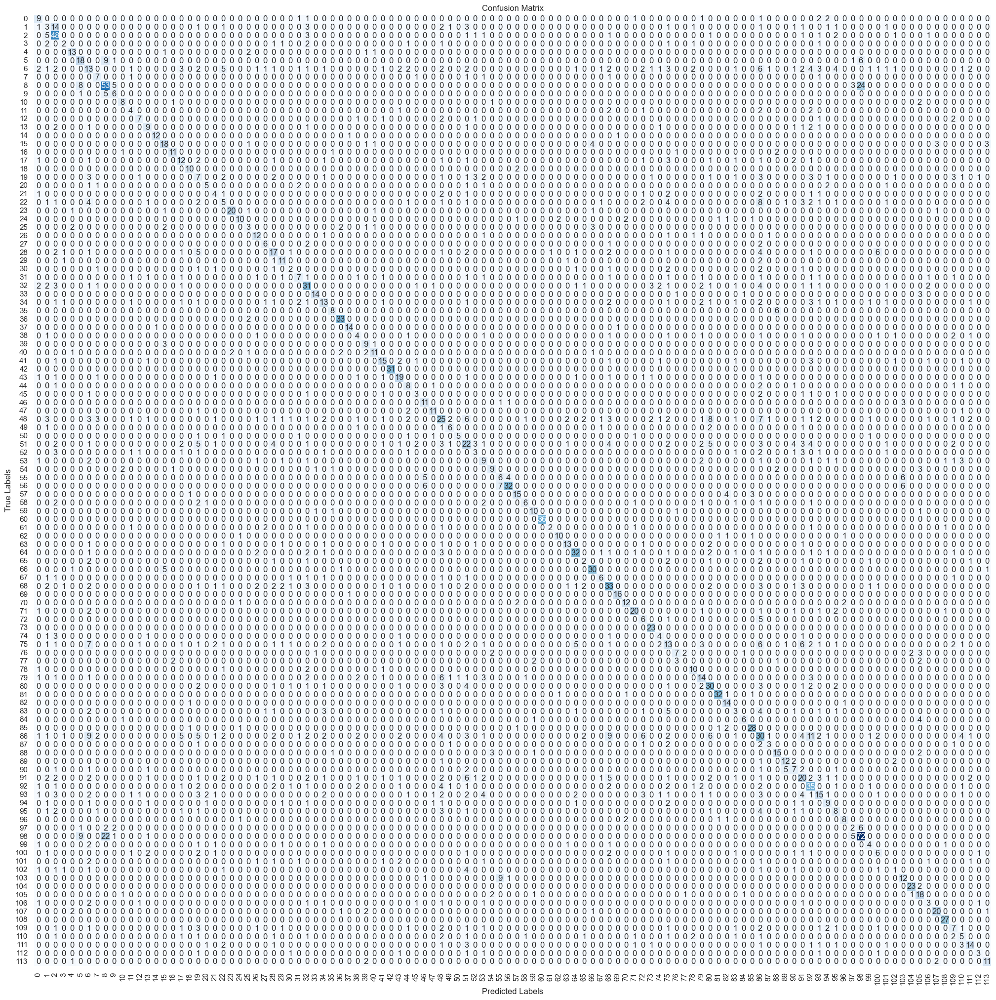

In [59]:
get_model_metrics("models/3.6/3.6_dense_net_trial_{}.h5".format(study.best_trial.number), y_test, [X_test_image, X_test_numerical, X_test_one_hot], k=3)

102/102 [==============================] - 32s 285ms/step


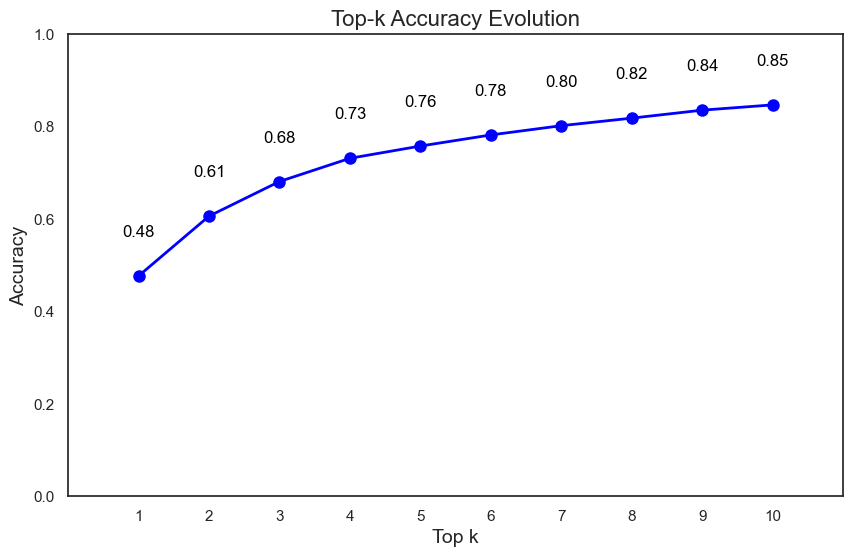

In [61]:
get_top_k_evolution_for_model("models/3.6/3.6_dense_net_trial_{}.h5".format(study.best_trial.number), y_test, [X_test_image, X_test_numerical, X_test_one_hot], k_maximum=10)

#### **Res Net**

In [62]:
# Check the model's summary to decide from which layer onwards to start the unfreezing process
base_model = ResNet50(weights='imagenet', include_top=False)
base_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, None, None, 3)        0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, None, None, 64)       9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, None, None, 64)       256       ['conv1_conv[0][0]']          
 on)                                                                                       

In [63]:
def create_model(trial):
    
    # Define input layers
    image_input = Input(shape=(128, 128, 3), name='image_input')
    numerical_input = Input(shape=(1,), name='numerical_input')
    one_hot_input = Input(shape=(9,), name='one_hot_input')

    # Load ResNet50 with ImageNet weights as the base model
    base_model = ResNet50(include_top=False, weights="imagenet", input_tensor=image_input)

    # Make only the last 15 layers trainable
    for layer in base_model.layers[:-15]:
        layer.trainable = False
    for layer in base_model.layers[-15:]:
        layer.trainable = True

    # Image processing branch
    x = GlobalAveragePooling2D()(base_model.output)
    x = BatchNormalization()(x)
    x = Dropout(trial.suggest_float("dropout_rate", 0.3, 0.5))(x)

    # Numerical data processing branch
    y = Dense(trial.suggest_categorical("num_units", [16, 32, 64]), activation='relu')(numerical_input)
    y = BatchNormalization()(y)

    # One-hot encoded data processing branch
    z = Dense(trial.suggest_categorical("num_units_one_hot", [16, 32, 64]), activation='relu')(one_hot_input)
    z = BatchNormalization()(z)

    # Concatenate all layers
    combined = concatenate([x, y, z])
    combined = Dense(512, activation='relu')(combined)
    combined = BatchNormalization()(combined)
    combined = Dropout(trial.suggest_float("dropout_rate_combined", 0.3, 0.7))(combined)
    output = Dense(114, activation='softmax')(combined)

    # Compile the model
    # Optimizers to tune
    optimizer_options = ['Adam', 'SGD', 'Adagrad']
    optimizer_selected = trial.suggest_categorical('optimizer', optimizer_options)

    # Learning rates to tune
    lr = trial.suggest_float("lr", 1e-3, 1e-2 , log=True)
    optimizer = {
        'Adam': Adam(lr=lr),
        'SGD': SGD(lr=lr),
        'Adagrad': Adagrad(lr=lr)
    }[optimizer_selected]

    model = Model(inputs=[image_input, numerical_input, one_hot_input], outputs=output)
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model


def objective(trial):

    model = create_model(trial)
    model_checkpoint = ModelCheckpoint("models/3.6/3.6_res_net_trial_{}.h5".format(trial.number), monitor='val_loss', save_best_only=True, verbose=1)

    # Define callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.0001, verbose=1)

    # Fit the model
    history = model.fit(
        [X_train_image_augmented, X_train_numerical_augmented, X_train_one_hot_augmented], y_train_augmented,
        validation_data=([X_val_image, X_val_numerical, X_val_one_hot], y_val),

        # Batch size to be tuned
        epochs=20, batch_size=trial.suggest_categorical('batch_size', [32, 64, 128]),
        callbacks=[early_stopping, reduce_lr, model_checkpoint],
        verbose=0
    )

    # Evaluate the model
    loss, accuracy = model.evaluate([X_val_image, X_val_numerical, X_val_one_hot], y_val, verbose=0)
    return accuracy

# Optuna study
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=3)

# Output the results
best_trial = study.best_trial
print(f"Best trial accuracy: {best_trial.value}")
print(f"Best hyperparameters: {best_trial.params}")

[I 2024-04-25 17:21:24,935] A new study created in memory with name: no-name-3c63efeb-5d1b-467d-8829-ebbf218c4909



Epoch 1: val_loss improved from inf to 4.18661, saving model to models/3.6\3.6_res_net_trial_0.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 4.18661 to 3.81441, saving model to models/3.6\3.6_res_net_trial_0.h5

Epoch 3: val_loss improved from 3.81441 to 3.68109, saving model to models/3.6\3.6_res_net_trial_0.h5

Epoch 4: val_loss improved from 3.68109 to 3.52022, saving model to models/3.6\3.6_res_net_trial_0.h5

Epoch 5: val_loss did not improve from 3.52022

Epoch 6: val_loss improved from 3.52022 to 3.46116, saving model to models/3.6\3.6_res_net_trial_0.h5

Epoch 7: val_loss did not improve from 3.46116

Epoch 8: val_loss did not improve from 3.46116

Epoch 9: val_loss improved from 3.46116 to 3.20851, saving model to models/3.6\3.6_res_net_trial_0.h5

Epoch 10: val_loss did not improve from 3.20851

Epoch 11: val_loss did not improve from 3.20851

Epoch 12: ReduceLROnPlateau reducing learning rate to 0.0009999999776482583.

Epoch 12: val_loss did not improve from 3.20851

Epoch 13: val_loss improved from 3.20851 to 2.93185, saving model to models/3.6\3.6_res_net_trial_0.h5

Epoch 14: v

[I 2024-04-25 18:51:29,134] Trial 0 finished with value: 0.24475955963134766 and parameters: {'dropout_rate': 0.4901042188462838, 'num_units': 64, 'num_units_one_hot': 16, 'dropout_rate_combined': 0.594095932839448, 'optimizer': 'SGD', 'lr': 0.0012309433503342557, 'batch_size': 32}. Best is trial 0 with value: 0.24475955963134766.



Epoch 1: val_loss improved from inf to 4.23035, saving model to models/3.6\3.6_res_net_trial_1.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss did not improve from 4.23035

Epoch 3: val_loss did not improve from 4.23035

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 4: val_loss did not improve from 4.23035

Epoch 5: val_loss improved from 4.23035 to 3.10368, saving model to models/3.6\3.6_res_net_trial_1.h5

Epoch 6: val_loss did not improve from 3.10368

Epoch 7: val_loss improved from 3.10368 to 3.00324, saving model to models/3.6\3.6_res_net_trial_1.h5

Epoch 8: val_loss did not improve from 3.00324

Epoch 9: val_loss did not improve from 3.00324

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0001.

Epoch 10: val_loss did not improve from 3.00324

Epoch 11: val_loss did not improve from 3.00324

Epoch 12: val_loss did not improve from 3.00324


[I 2024-04-25 19:42:20,602] Trial 1 finished with value: 0.23242910206317902 and parameters: {'dropout_rate': 0.3079846896202445, 'num_units': 32, 'num_units_one_hot': 32, 'dropout_rate_combined': 0.48126515321318375, 'optimizer': 'Adam', 'lr': 0.006942782414057733, 'batch_size': 64}. Best is trial 0 with value: 0.24475955963134766.



Epoch 1: val_loss improved from inf to 3.72095, saving model to models/3.6\3.6_res_net_trial_2.h5


C:\Users\sebas\anaconda3\envs\main_env\lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss did not improve from 3.72095

Epoch 3: val_loss did not improve from 3.72095

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.0009999999776482583.

Epoch 4: val_loss did not improve from 3.72095

Epoch 5: val_loss improved from 3.72095 to 3.02925, saving model to models/3.6\3.6_res_net_trial_2.h5

Epoch 6: val_loss did not improve from 3.02925

Epoch 7: val_loss did not improve from 3.02925

Epoch 8: ReduceLROnPlateau reducing learning rate to 0.0001.

Epoch 8: val_loss did not improve from 3.02925

Epoch 9: val_loss improved from 3.02925 to 3.00208, saving model to models/3.6\3.6_res_net_trial_2.h5

Epoch 10: val_loss improved from 3.00208 to 2.99507, saving model to models/3.6\3.6_res_net_trial_2.h5

Epoch 11: val_loss improved from 2.99507 to 2.99409, saving model to models/3.6\3.6_res_net_trial_2.h5

Epoch 12: val_loss did not improve from 2.99409

Epoch 13: val_loss did not improve from 2.99409

Epoch 14: val_loss improved from 2.99409 to 2.99061, saving 

[I 2024-04-25 21:08:14,327] Trial 2 finished with value: 0.23150432109832764 and parameters: {'dropout_rate': 0.30469269440841373, 'num_units': 16, 'num_units_one_hot': 64, 'dropout_rate_combined': 0.4276236581150925, 'optimizer': 'SGD', 'lr': 0.0021772540188162884, 'batch_size': 32}. Best is trial 0 with value: 0.24475955963134766.


Best trial accuracy: 0.24475955963134766
Best hyperparameters: {'dropout_rate': 0.4901042188462838, 'num_units': 64, 'num_units_one_hot': 16, 'dropout_rate_combined': 0.594095932839448, 'optimizer': 'SGD', 'lr': 0.0012309433503342557, 'batch_size': 32}


Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 image_input (InputLayer)    [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 134, 134, 3)          0         ['image_input[0][0]']         
                                                                                                  
 conv1_conv (Conv2D)         (None, 64, 64, 64)           9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 64, 64, 64)           256       ['conv1_conv[0][0]']          
 on)                                                                                        

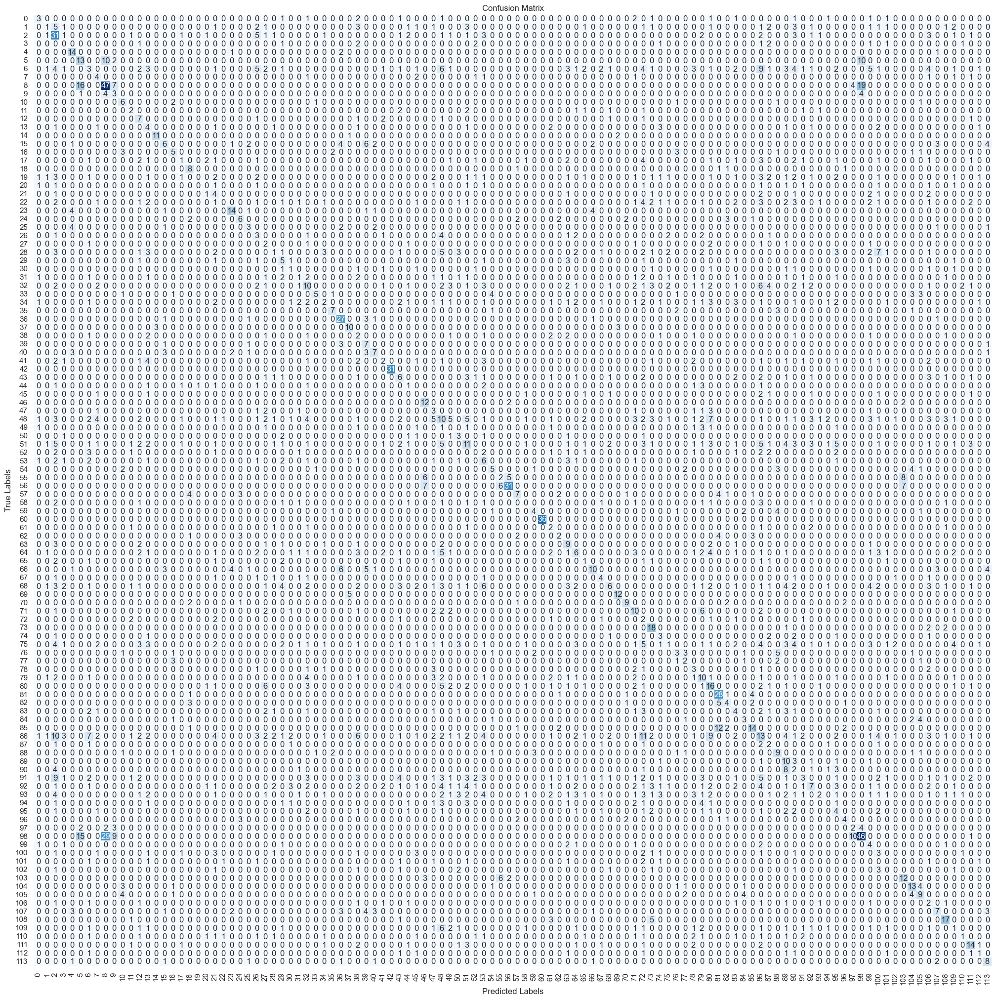

In [65]:
get_model_metrics("models/3.6/3.6_res_net_trial_{}.h5".format(study.best_trial.number), y_test, [X_test_image, X_test_numerical, X_test_one_hot], k=3)

102/102 [==============================] - 22s 211ms/step


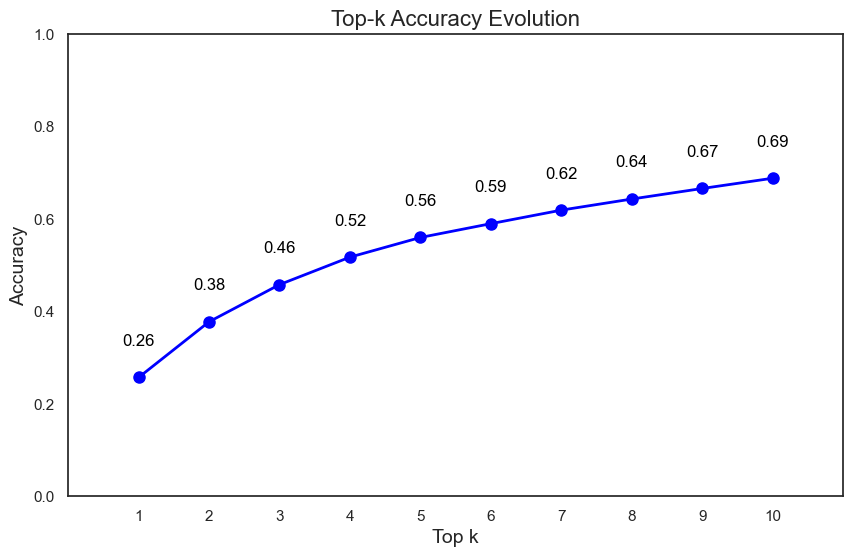

In [66]:
get_top_k_evolution_for_model("models/3.6/3.6_res_net_trial_{}.h5".format(study.best_trial.number), y_test, [X_test_image, X_test_numerical, X_test_one_hot], k_maximum=10)

<a id='Evaluation-of-the-best-Model'></a>
# 4. Evaluation of the best Model

In [161]:
# Load the best performant model
model_path = "models/3.6/3.6_dense_net_trial_2.h5"
model = load_model(model_path)

# Predict the probabilities for each class for the test dataset
probabilities = model.predict([X_test_image, X_test_numerical, X_test_one_hot])

# Get the indices of the top 7 probabilities
top_k_indices = np.argsort(probabilities, axis=1)[:, -7:][:, ::-1]

class_names = label_encoder.inverse_transform(range(len(label_encoder.classes_)))

# Map indices to class names
top_k_class_names = np.array([class_names[indices] for indices in top_k_indices])

# Convert the numpy array of top 7 predictions into a list of lists (one list per record)
predicted_list = top_k_class_names.tolist()

# Create a DataFrame from the test datasets
test_df = pd.DataFrame({
    'fitzpatrick_average': X_test_numerical.flatten(),
    '7_list_labels': predicted_list
})

# Merge with the one-hot encoded data
test_df = pd.concat([test_df, X_test_one_hot.reset_index(drop=True)], axis=1)

# Add the actual label back to the DataFrame
test_df['actual_label'] = [class_names[label] for label in y_test]

# Consolidate One-Hot Encoded Features into a single variable
def consolidate_one_hot(row, columns):
    active = [col.split('_')[-1] for col in columns if row[col] == 1]
    return ', '.join(active)

one_hot_columns = [col for col in X_test_one_hot.columns]
test_df['nine_partition_label'] = test_df.apply(lambda row: consolidate_one_hot(row, one_hot_columns), axis=1)

# Reorder columns to place predicted labels next to actual labels
column_order = ['fitzpatrick_average', 'nine_partition_label', '7_list_labels', 'actual_label'] + one_hot_columns
test_df = test_df[column_order]

# Remove individual one-hot columns since it's no longer needed
test_df.drop(columns=one_hot_columns, inplace=True)

test_df.head()


102/102 [==============================] - 95s 888ms/step


,fitzpatrick_average,nine_partition_label,7_list_labels,actual_label
0,0.6,inflammatory,"[papilomatosis confluentes and reticulate, urt...",papilomatosis confluentes and reticulate
1,0.4,genodermatoses,"[incontinentia pigmenti, acrodermatitis entero...",incontinentia pigmenti
2,0.3,inflammatory,"[scabies, allergic contact dermatitis, lichen ...",scabies
3,0.2,inflammatory,"[porphyria, tick bite, psoriasis, scabies, ery...",lupus subacute
4,0.6,inflammatory,"[scleroderma, photodermatoses, urticaria, alle...",urticaria


**The diseases labelled with 8, 86, 98 as Label Encoder were identified to be the ones with the highest number of misclassifications. A sample of pictures belonging to those classes will be shown as follows**

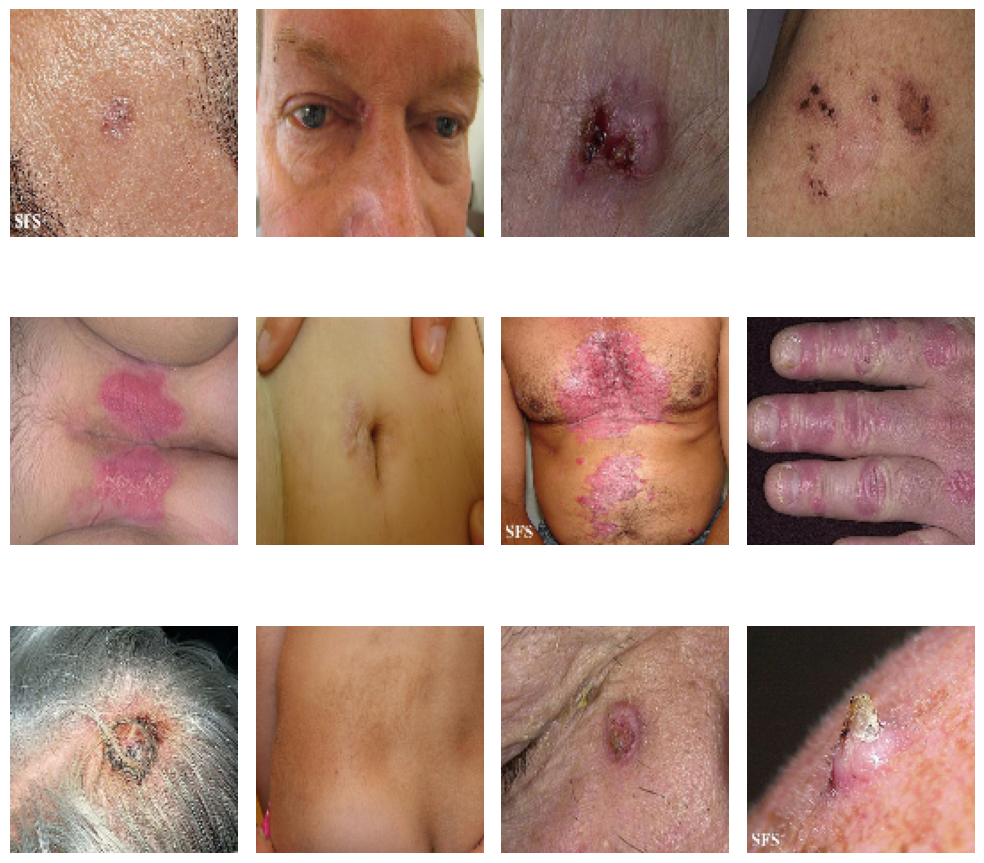

In [164]:
# Class labels
classes_to_sample = [8, 86, 98]

# Number of samples per class
samples_per_class = 4


fig, axs = plt.subplots(len(classes_to_sample), samples_per_class, figsize=(10, 10))

for i, class_num in enumerate(classes_to_sample):
    
    # Find indices where the class label equals the current class number
    class_indices = np.where(y_test == class_num)[0]
    
    # Randomly select 'samples_per_class' images from these indices
    selected_indices = np.random.choice(class_indices, samples_per_class, replace=False)
    
    for j, idx in enumerate(selected_indices):
        
        # Load the image
        img = X_test_image[idx]
        
        # Plot the image
        axs[i, j].imshow(img)
        axs[i, j].axis('off') 
        
        if j == 0:
            axs[i, j].set_ylabel(f"Class {class_num}", size='large')

plt.tight_layout()
plt.show()

<a id='Gradient-weighted-Class-Activation-Mapping'></a>
# 5. Gradient-weighted Class Activation Mapping

In [165]:
# Load the best performant model without Functional API
model_path = "models/3.5/3.5_dense_net_trial_1"
model = load_model(model_path)

# Check the model's summary to know the last Convolutional Layer's name for the Gradient-weighted Class Activation Mapping plot 
model.summary()


Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 134, 134, 3)          0         ['input_1[0][0]']             
 g2D)                                                                                             
                                                                                                  
 conv1/conv (Conv2D)         (None, 64, 64, 64)           9408      ['zero_padding2d[0][0]']      
                                                                                                  
 conv1/bn (BatchNormalizati  (None, 64, 64, 64)           256       ['conv1/conv[0][0]']   

In [166]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    
    # Create a model that maps the input image to the activations of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], 
        [model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:

        tape.watch(img_array)
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    # Compute the gradient of the class channel with respect to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, conv_outputs)
    
    # Global average pooling to obtain the importance of each feature map
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # Weight the output feature map with these importances
    heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_outputs), axis=-1)

    # Normalize the heatmap
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()


def display_gradcam(img, heatmap, alpha=0.003):
    
    if len(img.shape) == 4:
        img = img.squeeze(0)
    
    # Convert heatmap to RGB
    heatmap = np.uint8(255 * heatmap)
    jet = plt.get_cmap("jet")
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    jet_heatmap = jet_heatmap.squeeze(0)  # Remove the batch dimension
    
    # Create an image with RGB colorized heatmap
    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on the original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    return img, superimposed_img


# Predict the probabilities for each class for the test dataset
probabilities = model.predict(X_test_image)

# Get the index of the top 1 probability
top_k_indices = np.argmax(probabilities, axis=1)

class_names = label_encoder.inverse_transform(range(len(label_encoder.classes_)))

# Map indices to class names
top_k_class_names = [class_names[indices] for indices in top_k_indices]

# Create a DataFrame from the test datasets
test_df = pd.DataFrame({
    'predicted_label': top_k_class_names
})

# Add the actual label to the DataFrame
test_df['actual_label'] = [class_names[label] for label in y_test]


def plot_final(img_index):    # Specify the last convolutional layer name
    last_conv_layer_name = 'conv5_block30_2_conv'
    
    img_array = np.expand_dims(X_test_image[img_index], axis=0) 
    img = img_to_array(X_test_image[img_index]) 
        
    # Convert the numpy array to a TensorFlow tensor
    img_tensor = tf.convert_to_tensor(img_array, dtype=tf.float32)
    
    heatmap = make_gradcam_heatmap(img_tensor, model, last_conv_layer_name, img_index)
    original_img, gradcam_img = display_gradcam(img_array, heatmap)
    
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    # Display original image
    axs[0].imshow(original_img) 
    axs[0].axis('off')
    axs[0].set_title('Original Image')
    
    # Display Grad-CAM image
    axs[1].imshow(gradcam_img)
    axs[1].axis('off')
    axs[1].set_title('Grad-CAM')
    
    # Display Heatmap alone with color scale
    heatmap_resized = np.uint8(plt.get_cmap("jet")(np.uint8(255 * heatmap.squeeze()))[:, :, :3] * 255)
    axs[2].imshow(heatmap_resized)
    axs[2].axis('off')
    axs[2].set_title('Heatmap')

102/102 [==============================] - 105s 944ms/step


In [167]:
# Getting only the indices of the correctly classified images to show on the Grad-CAM
indices = test_df[test_df['predicted_label'] == test_df['actual_label']].index
indices

Index([   0,    5,    8,   11,   14,   18,   20,   22,   24,   25,
       ...
       3209, 3214, 3215, 3217, 3218, 3219, 3226, 3235, 3236, 3240],
      dtype='int64', length=1050)

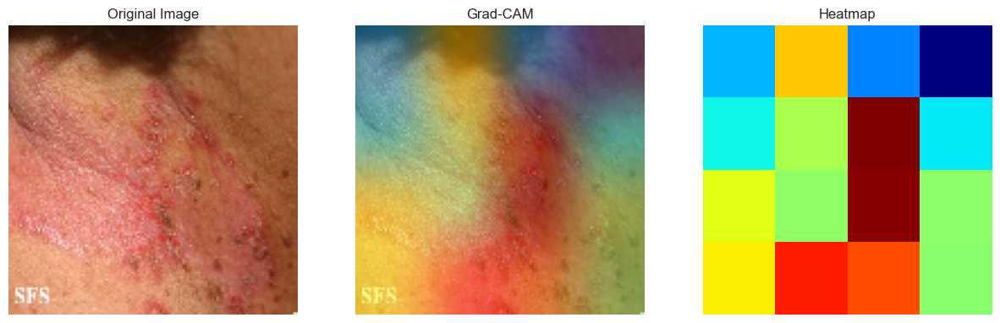

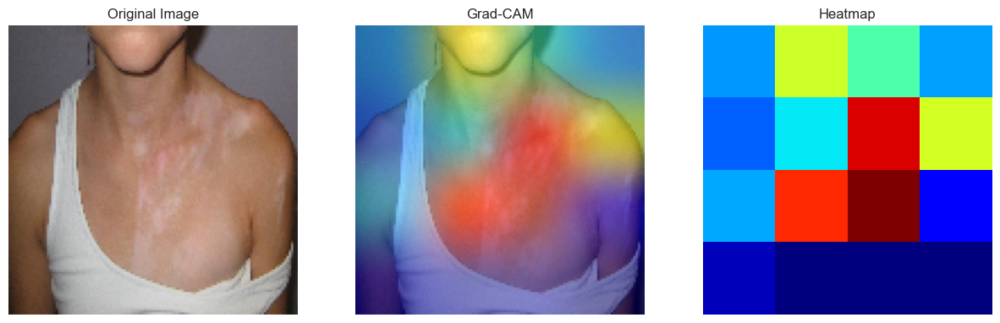

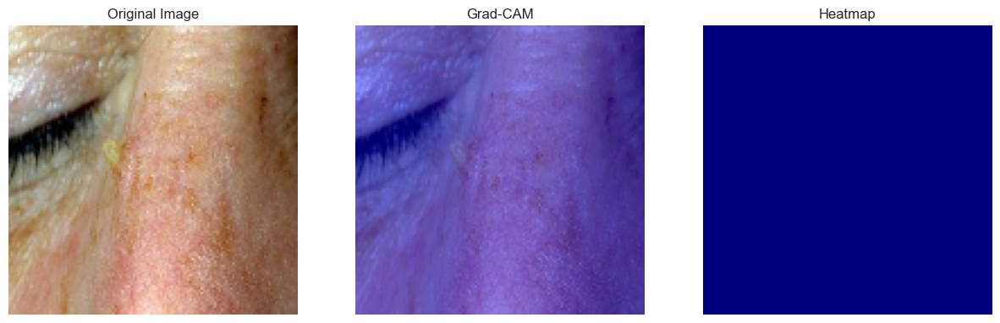

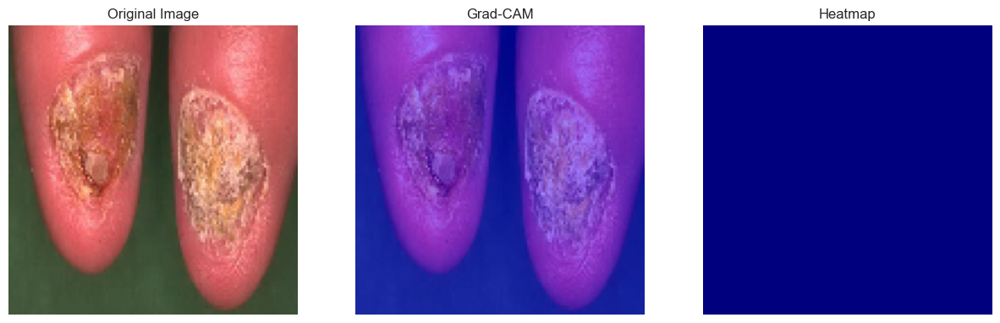

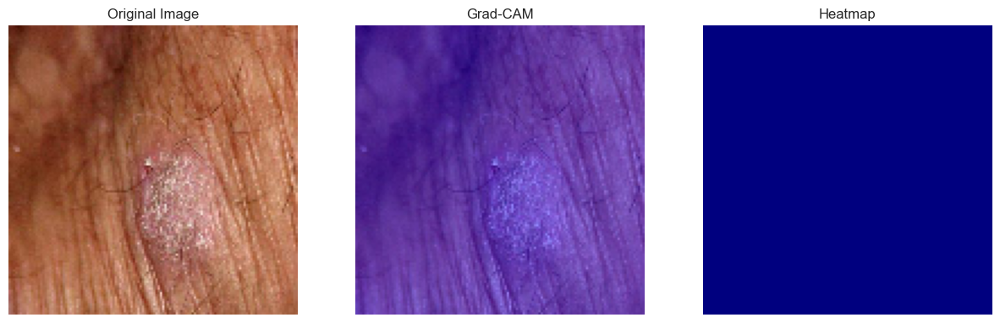

...

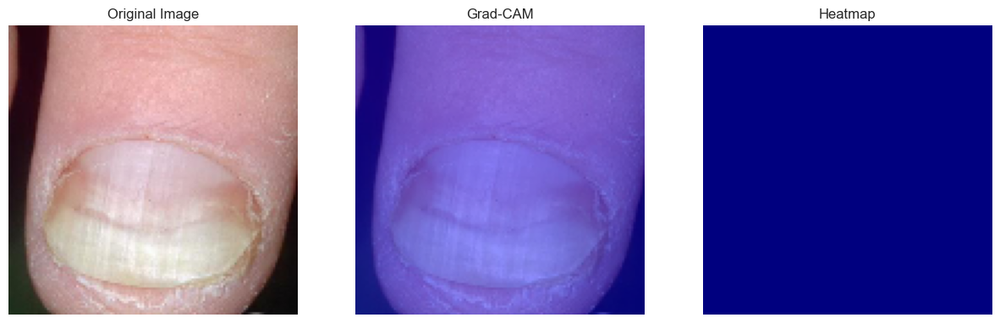

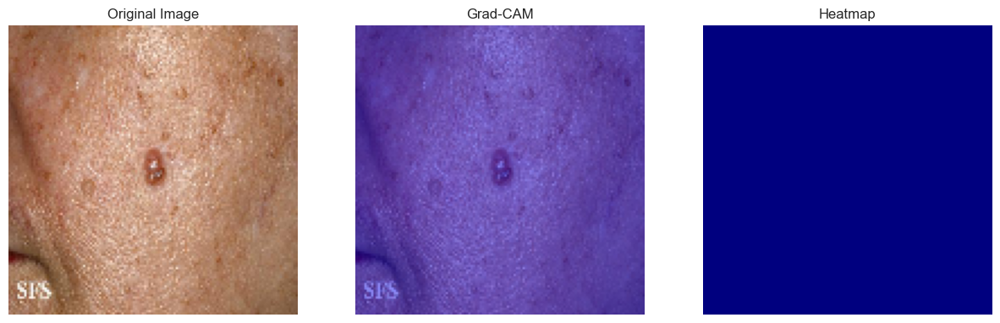

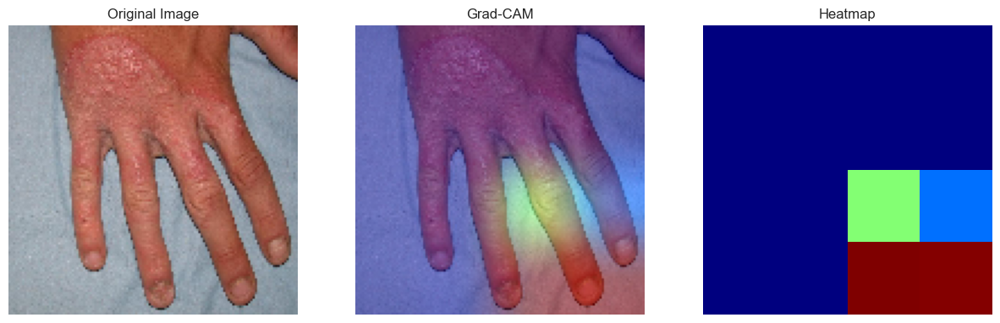

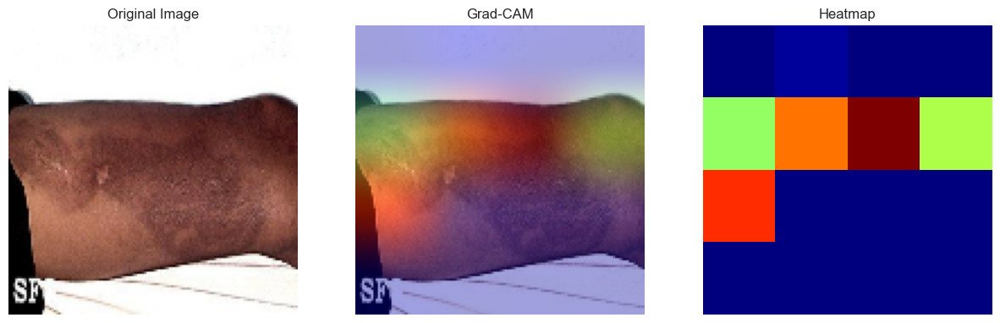

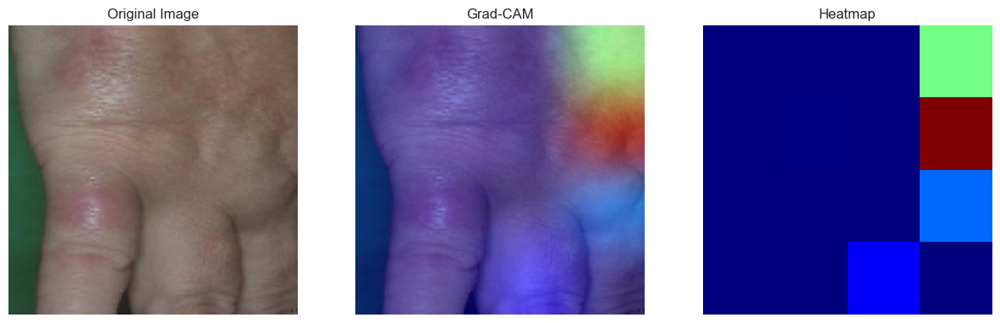

In [113]:
for img_index in indices[10:21]:
    plot_final(img_index)

<a id='Summary-of-the-results-and-Future-Work'></a>
# 6. Future Work

**More Optuna Trials with Data Augmentation:** Given additional time, an expansion of Optuna trials for pre-trained models using Data Augmentation and Functional API techniques would be conducted. Results using these methodologies were promising, suggesting that a more thorough exploration of hyperparameters might uncover even superior configurations. This expanded search would aim to optimize the models further, potentially enhancing their performance and generalizability.

**Different Unfreezing Strategies for Pre-trained Models:** Another area of potential improvement involves experimenting with various strategies for unfreezing layers in pre-trained models. Adjusting the depth of layer unfreezing could significantly affect the ability of the models to learn more complex patterns and generalize better on unseen data. More time would allow for systematic testing of these strategies to identify the most effective approach for each model type.

**More Advanced Data Augmentation Techniques:** Exploration of additional data augmentation techniques, such as adjustments in brightness and contrast, could be beneficial. These methods could help in creating a more robust model by training on images that closer mimic the variability found in real-world scenarios. Enhancing exposure to different lighting conditions and contrasts could improve diagnostic correctness.

**Requisition of Dataset Balance Regarding Skin Response to UV Light:** The dataset featured an average Fitzpatrick skin type of 2.65, on a scale from 1 to 6. A more balanced dataset in terms of skin response to ultraviolet light could potentially improve model performance, as the models would train on a representative spectrum of skin types. Engaging with data providers to acquire or generate a dataset with a more even distribution across the Fitzpatrick scales could enhance the model's utility across different demographic groups. This approach would not only improve model fairness but also its applicability in diverse clinical settings.